# HiC Genome assemblies - marmoratus inornatus

## Project information

**Organism(s) -** A. marmoratus, A. inornatus<br>
**Compute resource / project directory -** /fsimb/groups/imb-baumanngr/ao - INO_HIC_ASSEMBLER & MARM_HIC_ASSEMBLER, HIC_ASSEMBLER<br>
**Genome version(s) -** /fsimb/groups/imb-baumanngr/genomes/ - a_marmorata_unmasked.fasta, a_inornata_unmasked_doveTail.fasta (preHiC dovetail assemblies --> HiC chromosome-level assemblies)<br><br>
**General information -** Here I have assembled the inornatus and marmoratus genomes using the program I wrote contained in the HIC_ASSEMBLER directory. This will also be up on my github very soon (AO33 is my username). In essence, this is the jupyter notebook version of the two different assemblies that I have performed (which I much perfer do to control and ease of use). This notebook will give the same results as the executable version of the program. I assembled the genomes at two different contact map resolutions (500KB and 100KB). The 100Kb version of the inornatus assembly is ultimately what we will publish / send out to the internet! And the 100Kb marmoratus assembly that I did matches the Dovetail assembly that they performed for us, but my version doesn't include any scaffolds < 10Kb in length. The dovetail version of the marmoratus assembly is ultimately what we will publish however for various reasons. The 500Kb versions of these assemblies were mainly used for testing purposes due to how much faster the program runs whilst still giving high quality results. The first two parts of the pipeline/analysis (scaffold-->chromosomeAssignment, order/orient scaffolds within chromosome(s)) are by far the most computationaly intensive, while the last two parts (orient scaffolds < contactmap resolutionSize, write out assembled .fasta) are quite quick to run. Many more details can be found within the different sections of the notebook that explain the general workflow, and most functions are also self explanatory and or have docstrings associated with them :)<br><br>
**Input data -** The input to this program stems from HiCPro https://github.com/nservant/HiC-Pro, and utilizes the ice normalized contact maps from HiC data. It is expected that the user already has run their data through HiC pro and has generated all files both for the input to HiCpro (scaffoldSize file, restrictionEnzyme cutSite file, etc...) as well as the output from HiCPro (contact map matrix files, contact map .bed file, etc...) as many of these are used as input. The "**Initiation of global variables for pipeline**" markdown section contains some pretty self explanatory variable names that utlize these different files and dictate the output files as well.

## Imports

In [1]:
### This is for the first portion of assigning scaffolds to chromosomes ###
import math # Needed in the Chromosome finding section
import numpy # Needed in the Chromosome finding section
from numpy import trace as numpyTrace # Needed for ordering/orienting chromosomes
import scipy # Needed in the Chromosome finding section
import scipy.spatial # Needed in the chromosome finding section (clustering/dendrogram)
import scipy.cluster # Needed in the chromosome finding section (clustering/dendrogram)
from hmmlearn import hmm # Needed in the Chromosome finding section
import time # Just generally useful and is used in most sections
import copy # For ordering and orienting scaffolds
import networkx as nx # Needed in the Chromosome finding section
import community # Needed in the Chromosome finding section
import gzip # Needed in writing out of the final assembled fasta file
import numba ### Needed for ordering / orienting scaffolds
from numba import jit ### Needed for ordering / orienting scaffolds

### Contact map plotting ###
import matplotlib
import matplotlib.pyplot as plt
import xarray
### import plotContactMaps as plotModule ### Needed for part1 and part2 these lines are for the executable version of the program
### matplotlib.use('Agg') ### This is to suprress the Xwindows backend. Won't work on any of the compute clusters t have tried so far.
### This line will not allow a plot to be visualized in a jupyter notebook setting

## Code section for the entire pipeline

### Contact map initiation, and matrix manipulation code

In [2]:
### Matrix Initialization and manipulation code ###
class Bin:
    '''This object class represents a single genomic loci within the genome.
       It contains the base information from the output of HiC-Pro'''
    def __init__(self,ID,chrom,start,stop,bias,rowSum):
        self.ID = ID ### ID number give by HiC-Pro
        self.chrom = chrom ### Chromosome and or Scaffold the loci belongs to
        self.start = start ### Start coodinate (5'-3' with respect to positive strand)
        self.stop = stop ### Stop coordinate (5'-3' with respect to positive strand)
        self.bias = bias ### Bias value assigned by HiC-Pro
        self.rowSum = rowSum ### The total sum of interaction values (will be the same for all valid bin objects and zero for non valid objects due to the ICE Normalization step performed by HiCPro)

def initiateLoci(bedFile,biasFile,binID_dict=False):
    ''' This initiates our inititial objects (Bin) of genomic loci.
        Input = bedFile is the full file path to the bed file output by HiCPro
                biasFile is the full file path to the biasFile output by HiCPro
        Output = list of Bin objects'''
    binList = []
    bedFile = open(bedFile,'r')
    biasFile = open(biasFile,'r')
    while True:
        bedLine = bedFile.readline()
        biasLine = biasFile.readline()
        if not bedLine:
            break
        #####################################################
        bedCols = bedLine.strip('\r').strip('\n').split('\t')
        chrom,start,stop,bID = bedCols[0],int(bedCols[1]),int(bedCols[2]),int(bedCols[3])
        bias = biasLine.strip('\r').strip('\n')
        #######################
        if binID_dict != False:
            if bID not in binID_dict:
                continue
        #################
        if bias != "nan":
            try:
                biasValue = float(bias)
            except:
                biasValue = 0.
            binMan = Bin(bID,chrom,start,stop,biasValue,0.)
            binList.append(binMan)
    ###############
    bedFile.close()
    biasFile.close()
    print("Genomic loci found"+'\t'+str(len(binList)))
    return binList

def buildAdjacencyMatrix(matrixFile,binList,binID_dict=False):
    '''This builds our initial adjacency matrix from the interaction values provided by HiCPro
       Input = matrixFile is the ICE normalized matrix file produced by HiCPro
               binList is the list of Bin objects provided by the initiateLoci function
       Output = adjacency matrix of interaction values'''
    matrixFile = open(matrixFile,'r')
    adjacencyMatrix = [ [ 0. for i in range(0,len(binList)) ] for i in range(0,len(binList)) ]
    binIndexDict = { binMan.ID:i for i,binMan in enumerate(binList) }
    edgeCount = 0
    print("Adjacency matrix initiated")
    print("Adding edges...")
    for line in matrixFile:
        cols = line.strip('\r').strip('\n').split('\t')
        bID1,bID2,val = int(cols[0]),int(cols[1]),float(cols[2])
        if bID1 not in binIndexDict:
            continue
        if bID2 not in binIndexDict:
            continue
        adjacencyMatrix[ binIndexDict[bID1] ][ binIndexDict[bID2] ] = val
        adjacencyMatrix[ binIndexDict[bID2] ][ binIndexDict[bID1] ] = val
        edgeCount += 1
        if edgeCount % 1000000 == 0:
            print("Edges processed "+str(edgeCount))
    ##################
    matrixFile.close()
    ############################################################
    print("Edges added to adjacency matrix"+'\t'+str(edgeCount))
    print("Rows in adjacency matrix "+str(len(adjacencyMatrix)))
    return adjacencyMatrix

def removeRows(matrix,binList,zeroRows=True,biasVals=False):
    ''' Function to remove rows from the matrix 
        and remove the corresponding binObject from the binList. 
        Input is the matrix, and corresponding list of bin objects.
        If zeroRows==True then we remove rows that sum to zero
        If biasVals!=False then we only keep rows that satisify
           biaseVals[0] < rowBiasValue < biasVals[1]
        Input = adjacencyMatrix produced by the buildAdjacencyMatrix function
                list of Bin objects produced by the initiateLoci function
        Output = adjacencyMatrix and binList, both with removed rows/elements that sum to zero or have invalid biasValue'''
    indicesToRemove = []
    ###################################################################
    for i,rSum in enumerate(numpy.sum(numpy.asmatrix(matrix),axis=-1)):
        if zeroRows == True:
            if numpy.asarray(rSum) == 0:
                indicesToRemove.append(i)
                continue
        #######################
        if (biasVals != False):
            if (binList[i].bias > biasVals[1]) or (binList[i].bias < biasVals[0]):
                indicesToRemove.append(i)
    ##########################################################
    print("Rows/columns to remove "+str(len(indicesToRemove)))
    count = 0
    for i in indicesToRemove:
        del matrix[i-count]
        del binList[i-count]
        count += 1
    #############################
    for i,r in enumerate(matrix):
        count = 0
        for ii in indicesToRemove:
            del r[ii-count]
            count += 1
        binList[i].rowSum = sum(numpy.asarray(r))
    #####################
    return matrix,binList

def convertMatrix(adjacencyMatrix,binList,distance=True,similarity=False):
    '''This function is a general function to convert back and forth from a distance to a similarity matrix
       Input = adjacencyMatrix and corresponding Bin object list (we use the preComputed rowSum attribute of the binObjects to speed up the process )
       Output = transformed adjacencyMatrix'''
    startTime = time.time()
    adjacencyMatrix = scipy.asmatrix(adjacencyMatrix)
    ########################################
    for i,row in enumerate(adjacencyMatrix):
        if distance == True:
            adjacencyMatrix[i] = (1. - (row/row.sum())) + 1.
        elif similarity == True:
            adjacencyMatrix[i] = binList[i].rowSum*(1.-(row-1.))
    #################################################################################
    #condensedMatrix = scipy.spatial.distance.squareform(adjacencyMatrix,checks=False)
    ######################
    stopTime = time.time()
    print("Time to convert matrix "+str(stopTime-startTime))
    return adjacencyMatrix

def reorderMatrix(matrix,binList,newOrder):
    '''Fancy little function to reorder the rows and columns of our matrix according to new indices (also the list of Bin objects)
       Input = adjacencyMatrix, list of Bin objects, indices of newOrder
       Output = reordered matrix and list of Bin objects'''
    matrix = matrix[:, newOrder][newOrder]
    binList = [ binList[i] for i in newOrder ]
    return matrix,binList

def logTransformMatrix(matrix,logBase=10,reverse=False):
    '''Simple function to convert a matrix to and from a logTransform
       Input = matrix and logBase or reverse=True/False
       Output = transformed matrix'''
    matrix = scipy.asmatrix(matrix)
    newMat = [ [ 0.0 for ii in range(0,len(matrix)) ] for i in range(0,len(matrix)) ]
    if reverse == False:
        for i,row in enumerate(matrix):
            for ii,v in enumerate(numpy.asarray(row)[0]):
                if v != 0.:
                    newMat[i][ii] = math.log(float(v)+1.,logBase)
    #####
    else:
        for i,row in enumerate(matrix):
            for ii,v in enumerate(numpy.asarray(row)[0]):
                if v != 0.:
                    newMat[i][ii] = (float(logBase)**v)-1.
    #############################
    return numpy.asmatrix(newMat)

### UPGMA clustering code

In [3]:
def averageClusterNodes(adjacencyMatrix,nodeLabels,noPlot=True):
    '''Performs UPGMA (average) heirarchical clustering for a distance transformed adjacency matrix
       The actual matrix passed in is not altered in any way. It must be roered in another function
       Input = distance transformed adjacencyMatrix
               labels of the nodes of the dendrogram that is produced
       Output = dendrogram object produced by scipy.cluster.dendrogram'''
    startTime = time.time()
    condensedMatrix = scipy.spatial.distance.squareform(adjacencyMatrix,checks=False)
    stopTime = time.time()
    print("Time to condensed matrix "+str(stopTime-startTime))
    clustMan = scipy.cluster.hierarchy.average(condensedMatrix)
    if noPlot == False:
        fig = plt.figure()
        fig.set_size_inches(32,8)
        dendro = scipy.cluster.hierarchy.dendrogram(clustMan,labels=nodeLabels,leaf_rotation=90,no_plot=noPlot,get_leaves=True,count_sort ='descendent') ### This is what you use for clustering bins to chroms
        plt.show()
    else:
        dendro = scipy.cluster.hierarchy.dendrogram(clustMan,labels=nodeLabels,leaf_rotation=90,no_plot=noPlot,get_leaves=True,count_sort ='descendent') ### This is what you use for clustering bins to chroms
    ######################
    stopTime = time.time()
    print("Time to cluster "+str(stopTime-startTime))
    return dendro

def dendrogramLeafOrder_toFile(dendrogramObj,outFile):
    '''This is to simply write out the order of the nodes of the dendrogram produced by the averageClusterNodes function
       Input = dendrogram object from scipy, full file path to output file'''
    outFile = open(outFile,'w')
    for i,l in enumerate(dendrogramObj['ivl']):
        if i != (len(dendrogramObj['ivl'])-1):
            outFile.write(l+'\t'+str(dendrogramObj['leaves'][i])+'\n')
        else:
            outFile.write(l+'\t'+str(dendrogramObj['leaves'][i]))
    ###############
    outFile.close()

def readDengrogramLeavesFromFile(dendrogramFile):
    '''This simply reads in the output file from the dendrogramLeafOrder_toFile
       Input = full file path to dendrogramFile from dendrogramLeafOrder_toFile function
       Output = a dictionary with the same notation as the scipy dendrogram object, but only "ivl" and "leaves" are used" '''
    inFile = open(dendrogramFile,'r')
    dendoLeaves = { 'ivl':[],'leaves':[] }
    for line in inFile:
        cols = line.strip('\r').strip('\n').split('\t')
        dendoLeaves['ivl'].append(cols[0])
        dendoLeaves['leaves'].append(int(cols[-1]))
    ##############
    inFile.close()
    return dendoLeaves

### Chromosome assignment of bins via HMM and modularity code

In [4]:
def identifyBoundry(hiddenStates,cutIndices,switchCount=10):
    '''Simple heuristic function that identifies when a TRUE switch in states occured from the hidden markov model
       While each state has technically already predicted at this point, there is still some very small level of noise.
       The idea here is that when we see a dramatic switch from the start state to the next state we return the index where that happens.
       Input = decoded states of observations, matrix cutIndices
               switchCount defines how many consecutive non-startState observations we must see to then define the boundary
       Output = newely defined boundary'''
    ### We define our start state by the majority observation state of the first switchCount number of observations ###
    countDict = { 0:0, 1:0 }
    for s in hiddenStates[0:switchCount]:
        countDict[s] += 1
    startState = sorted([ [s,c] for s,c in countDict.items() ], key=lambda x: x[1], reverse=True)[0][0]
    ################################################################################################
    states = [ hiddenStates[ind:ind+switchCount] for ind in range(0,len(hiddenStates)-switchCount) ]
    cutInd = 0
    ###############################
    for ind,s in enumerate(states):
        switchState = sum([ 1 for hS in s if hS != startState ])
        if switchState == switchCount:
            cutInd = ind+cutIndices[-1]
            break
    #############
    return cutInd

def hmmChromosomes(adjacencyMatrix,cutIndices,binList,minSize=15,convergenceRounds=8,lookAhead=False):
    '''This function will be called to define a chromosome boundary in the UPGMA clustered matrix (but the logTransformed version NOT the distance version)
       In essence, we want to use a 2-state GaussianHMM where the first state (starting state) belongs to a single chromosome, and the 2nd state belongs to the remaining chromosome(s).
       But, there is a caveat in that sometimes the HMM will define multiple chromosomes belonging to the first state. If this happens, we remove all data pertaining to the second state,
       and then rerun the algorithm. We repeat this process until the algorithm/HMM converges on a single point in the matrix that separates the starting and second states.
       Only matrix rows/column indices of the matrix will be used corresponding the last entry of cutIndices and greater.
       Input = logTransformed adjacencyMatrix, list of chromosomeBoundaries (cutIndices) and the list of Bin objects
               convergenceRounds defines how many times we are allowed to run the algorithm (so we don't get stuck in an infinite loop, although this shouldn't happen)
               minSize defines the minimum chromosome size (in the number of genomic loci from HiCPro)
               lookAhead is the fraction of the matrix that we want to initially use for our HMM. The full matrix is recommended, but smaller values can improve runtime.
       Output = list of chromosomeBoundaries (cutIndices) with a newely appeneded boundary)'''
    adjacencyMatrix = numpy.asarray(adjacencyMatrix)
    ######################
    if lookAhead != False:
        lookAhead = int(float(len(adjacencyMatrix)) * lookAhead) + cutIndices[-1]
    else:
        lookAhead = len(adjacencyMatrix)
    ###################################
    prevCutInd,roundCount = lookAhead,1
    while roundCount <= convergenceRounds:
        ### This is for the termination of the algorithm if moudularity is set to zero percent of the data ###
        if (len(adjacencyMatrix)-cutIndices[-1])/2 < minSize:
            cutInd = prevCutInd
            cutIndices.append("NA")
            break
        ##############################################################################
        X = [ r[cutIndices[-1]:prevCutInd] for r in adjacencyMatrix[cutIndices[-1]:] ]
        startMat = numpy.asarray([  1. , .0 ] )
        transMat = numpy.asmatrix([ [ .9 , .1 ], [ 0.0001 , .9999 ] ])
        ##############################################################
        print("Input matrix size = "+str(len(X))+" x "+str(len(X[0])))
        print("HMM round = "+str(roundCount))
        model = hmm.GaussianHMM(n_components=2,covariance_type="diag",n_iter=1000,init_params="cm",params="cmt") # tested tried and true
        model.startmat_ = startMat
        model.transmat_ = transMat
        model.fit(X)
        hiddenStates = model.predict(X)
        cutInd = identifyBoundry(hiddenStates,cutIndices,switchCount=minSize)
        ########################
        if cutInd != prevCutInd:
            prevCutInd = cutInd
            roundCount += 1
            continue
        else:
            print("HMM convergence rounds = "+str(roundCount))
            cutIndices.append(int(cutInd))
            break
    ##################################
    if roundCount > convergenceRounds:
        cutIndices.append(int(cutInd))
        print("WARNING... HMM failed to converge after "+str(roundCount)+" rounds...")
        print("Proceeding with last found cutIndex of "+str(cutInd)+"...")
    #################
    return cutIndices

def modularityChromosomes(adjacencyMatrix,binList,cutIndices,louvainRounds=20):
    '''This function will identify communities (ie chromosomes) by using the Louvain method to optimize the modularity score of the input matrix
       This is used to define the chromosome boundaries of the smaller chromosomes usually.
       We convert our matrix to a network/graph and then identify wich matrix rows belong to which community/chromosome.
       Input = fullSize adjacency matrix, list of Bin objects, chromosomeBoundaries/cutIndices
               The last entry in cutIndices will be the starting index of the adjacencyMatrix generated from the full adjacencyMatrix
       Output = list of chromosomeBoundaries with the newely found ones via modularity maximization'''
    startTime = time.time()
    startIndex = cutIndices[-1]
    adjacencyMatrix = numpy.asarray(adjacencyMatrix)
    subGraph = nx.Graph()
    indexDict = { i:binObj.ID for i,binObj in enumerate(binList[startIndex:]) }
    ### Add nodes to graph ############
    for binObj in binList[startIndex:]:
        subGraph.add_node(binObj.ID)
    ### Add edges to graph ############################
    for i,r in enumerate(adjacencyMatrix[startIndex:]):
        for ii,v in enumerate(r[startIndex:]):                 
            subGraph.add_edge(indexDict[i],indexDict[ii],weight=v)
    ###########################################
    print("Maximizing so-called modularity...")
    print("Graph created with "+str(subGraph.number_of_nodes())+" nodes, and "+str(subGraph.number_of_edges())+" edges")
    print("Performing "+str(louvainRounds)+" rounds of the louvain method...")
    ##################
    bestModScore = -2.
    for i in range(0,louvainRounds):
        chromosomePartition = community.best_partition(subGraph,randomize=True)
        modScore = community.modularity(chromosomePartition,subGraph)
        if modScore > bestModScore:
            bestModScore = modScore
            bestPartition = chromosomePartition
            print("Louvain round "+str(i+1)+" , "+"ModScore "+str(modScore))
    ####################################################################################
    communityDict = { node:communityKey for node,communityKey in bestPartition.items() }
    chromCount = len({ communityKey:'' for communityKey in bestPartition.values() })
    prevComm = communityDict[indexDict[0]]
    for i in range(1,len(indexDict)):
        comm = communityDict[indexDict[i]]
        if comm != prevComm:
            cutIndices.append(i+startIndex)
            prevComm = comm
    #################################
    modTime = time.time() - startTime
    print("Chromosomes found via modularity maximization = "+str(chromCount))
    print("Modularity maximization total time = "+str(modTime))
    return cutIndices
    
def identifyChromosomeGroups(adjacencyMatrix,binList,minSize=15,modularity=.05,convergenceRounds=8,lookAhead=.5,louvainRounds=20):
    '''This function essentially wraps around the hmmChromosomes and modularityChromosomes functions
       to iteratively define chromosome boundaries in the input adjacencyMatrix.
       Input = logTransformed adjacencyMatrix, list of Bin objects
               minSize defines the minimum chromosome size (in the number of genomic loci from HiCPro)
               lookAhead is the fraction of the matrix that we want to initially use for our HMM. The full matrix is recommended, but smaller values can improve runtime
               modularity is the fraction of the lower right hand side of the matrix to perform modularity calculations on. Can be set to zero, but this might give weird results...
               louvainRounds is the number of initiations of the Louvain method to perform. 
                             We randimize the order in which we iterate through the graph nodes each round of the Louvain algorithm to avoid potential suboptimal Modularity scores
       Output = list of chromosomeBoundaries (indices of the input adjacencyMatrix that define our chromosome boundaries)'''
    print("#########################"+'\n'+"#########################")
    print("Working on iterative 2 state HMMs to identify chromosome boundaries...")
    startTime = time.time()
    adjacencyMatrix = scipy.asmatrix(adjacencyMatrix)
    matrixLength = float(len(adjacencyMatrix))
    remainder = matrixLength - (modularity*matrixLength)
    modFallBack,cutIndices = 0,[0]
    ##################################
    while cutIndices[-1] <= remainder:
        print("#########################"+'\n'+"#########################")
        cutIndices = hmmChromosomes(adjacencyMatrix,cutIndices,binList,
                                    minSize=minSize,
                                    convergenceRounds=convergenceRounds,
                                    lookAhead=lookAhead)
        ########################################
        print("Cut indices =  "+str(cutIndices))
        if cutIndices[-1] == 0:
            print("Algorithm terminated. No obvious chromome boundry could be found... ")
            break
        ##########################
        if cutIndices[-1] == "NA":
            modFallBack = 1
            cutIndices.pop(-1)
            break
    ######################
    if cutIndices[0] == 0:
        cutIndices.pop(0)
    ###################################################################
    print("#########################"+'\n'+"#########################")
    print("HMM rounds completed in "+str(time.time()-startTime)+" seconds")
    print("Chromosome groups found via HMMs "+str(len(cutIndices))+" / "+str(len(cutIndices)+1))
    ####################
    if modFallBack == 0:
        print("#########################"+'\n'+"#########################")
        cutIndices = modularityChromosomes(adjacencyMatrix,binList,cutIndices,louvainRounds=louvainRounds)
        print("#########################"+'\n'+"#########################")
    #############################################################################################
    print("Total time to identify chromosome boundries = "+str(time.time()-startTime)+" seconds")
    print("Chromosomes found = "+str(len(cutIndices)+1))
    #################
    return cutIndices

def writeBinGroupingsToFile(coords,binList,outFile):
    '''This function writes the genomic loci (Bin objects) associated with each chromosome found to a file.
       Just a simple intermediate file that is then used in the final step of scaffold to chromosome assignment. Chromosome names in this file are just place holders. NOT final
       Input = list of chromosomeBoundaries/matrix cutIndices identifed by the identifyChromosomeGroups function
               list of Bin objects that contain the actual informatin we will be writing out
               full file path to the output file'''
    chromGroups = []
    prevIndex = 0
    for cutIndex in coords:
        chromGroups.append(binList[prevIndex:cutIndex])
        prevIndex = cutIndex
    chromGroups.append(binList[prevIndex:])
    ###########################
    outFile = open(outFile,'w')
    for i,chrGroup in enumerate(chromGroups):
        outFile.write("### Chromosome group "+str(i+1)+" ###"+'\n')
        for binObj in chrGroup:
            outFile.write(str(binObj.ID)+'\t'+binObj.chrom+'\t'+str(binObj.start)+'\t'+str(binObj.stop)+'\t'+str(binObj.bias)+'\n')
    ###############
    outFile.close()

### Scaffold assignment to chromosome and renaming of chromosomes based on size code

In [5]:
def readSizeFileToDict(sizeFile):
    '''Takes the hicPro scaffold size file and reads it into memory"
       Input = full file path to scaffold size file
       Output = { scaffoldName:size }'''
    scaffDict = {}
    inFile = open(sizeFile,'r')
    for line in inFile:
        cols = line.strip('\r').strip('\n').split('\t')
        scaffDict.update({ cols[0]:int(cols[1]) })
    ##############
    inFile.close()
    return scaffDict

def readBinGroupingsFromFile(binGroupingsFile):
    '''Reads in the bin/chromosome groups file from the initital UPGMA clustering-->HMM/Modularity chromosome group assignment.
       Input = binGroupings full file path
       Output = A list of chromosome groups, where each element in the list is another list, where each element is a line from the input file'''
    chromList,chromGroup = [],[]
    inFile = open(binGroupingsFile,'r')
    inFile.readline()
    for line in inFile:
        line = line.strip('\n').strip('\r')
        if line[0] != "#":
            chromGroup.append(line)
        else:
            chromList.append(chromGroup)
            chromGroup = []
    ############################
    chromList.append(chromGroup)
    inFile.close()
    print(str(len(chromList))+" chromosomes read in from file")
    return chromList

def assessClusterList(cList,scaffDict,outFile,percentToAssign=51.):
    '''One of these function calls is used per chromosome group found, and assigns scaffolds to a particular chromosome group.
       Input = cList is the list of lines read in from the binGroupings file (contains information about a particular bin, its ID and scaffold)
               scaffDict = { scaffoldName:[ binIDs belonging to the scaffold ] }
               outFile = variable name with which an output file has been opened for writing with. Note!!! The chromosome group names are not necessarily final.
                           They are only finalized in the writeChromosomeGroupingsToFile function
               percentToAssign = percentage of bins belonging to a scaffold that are found in the cList input argument for confident assignment to this chromosome group
       Output = List of binIDs assigned to chromosome
                List of false positive bin IDs that do not belong to the chromosome
                Number of scaffolds found assigned to chromosome'''
    scaffs = {}
    for c in cList:
        binID,scaff = int(c.split('\t')[0]),c.split('\t')[1]
        if scaff not in scaffs:
            scaffs.update({scaff:[binID]})
        else:
            scaffs[scaff].append(binID)
    ####################
    finalClustering = []
    totalScaffoldsAssigned = 0
    falsePositives = 0
    outFile.write("#Scaffold"+'\t'+"NodesAssigend"+'\t'+"TotalNodes"+'\t'+"Assigned%"+'\n')
    for s,nodeList in scaffs.items():
        nodesAssigned,totalNodes = len(nodeList),len(scaffDict[s])
        percentAssigned = round(((float(nodesAssigned)/float(totalNodes)) * 100.),2)
        outFile.write(str(s)+'\t'+str(nodesAssigned)+'\t'+str(totalNodes)+'\t'+str(percentAssigned)+"%"+'\n')
        if percentAssigned >= percentToAssign:
            finalClustering += scaffDict[s]
            totalScaffoldsAssigned += 1
        else:
            falsePositives += nodesAssigned
    ###############################################################################
    outFile.write("Total scaffolds clustered to chromosome "+str(len(scaffs))+'\n')
    outFile.write("Total scaffolds assigned to chromosome "+str(totalScaffoldsAssigned)+'\n')
    ############################################################
    return finalClustering,falsePositives,totalScaffoldsAssigned
        
def assessChromosomeClustering(chromList,statsFile,percentToAssign=51.):
    '''Assignes scaffolds to chromosomes.
       Input = output of the readBinGroupings file
               percentToAssign = percentage of bins belonging to a scaffold that are found in the cList input argument for confident assignment to this chromosome group
               statsFile = full filePath to stats regarding the clustering assessment. Note!!! The chromosome group names are not necessarily final.
                           They are only finalized in the writeChromosomeGroupingsToFile function
       Output = List of lists of binIDs belonging to any given chromosome group'''
    ### First figure out how many nodes are contained within each scaffold ###
    scaffolds = {}
    fullNodeList = [ cc for c in chromList for cc in c]
    for node in fullNodeList:
        binID,scaff = int(node.split('\t')[0]),node.split('\t')[1]
        if scaff not in scaffolds:
            scaffolds.update({scaff:[[binID,scaff]]})
        else:
            scaffolds[scaff].append([binID,scaff])
    for s in scaffolds:
        scaffolds[s] = sorted(scaffolds[s],key=lambda x: x[0])
    ##############################################################################
    ### For each chromosome found, assign scaffolds based on simple heuristics ###
    finalChromList = []
    falsePositives = 0
    totalScaffsAssigned = 0
    outFile = open(statsFile,'w')
    for i,c in enumerate(chromList):
        outFile.write("### Chromosome"+str(i+1)+" ###"+'\n')
        chromosomeNodes,falsePos,scaffsAssigned = assessClusterList(c,scaffolds,outFile,percentToAssign=percentToAssign)
        if len(chromosomeNodes) > 0:
            finalChromList.append(chromosomeNodes)
        falsePositives += falsePos
        totalScaffsAssigned += scaffsAssigned
        outFile.write("####################"+'\n')
    ##############################
    totalNodes = len(fullNodeList)
    outFile.write("Total Nodes "+str(len(fullNodeList))+'\n')
    outFile.write("Properly clustered nodes "+str(totalNodes-falsePositives)+'\n')
    outFile.write("Falsely clustered nodes "+str(falsePositives)+'\n')
    outFile.write("Total scaffolds assigned to chromosomes "+str(totalScaffsAssigned)+'\n')
    outFile.write("Error rate ~"+str(round((float(falsePositives)/float(totalNodes)) * 100., 2))+"%"+'\n')
    return finalChromList

def writeChromosomeGroupingsToFile(chromList,scaffSizeDict,outFile):
    '''Writes out our chromosome groups to a new file that is sorted by the size of the chromosome (biggest chromosome = Chr_1)
       Very similar to the binGroupings file, but ordered by size and doesnt contain the bias values.
       Input = output from the assessChromosomeClustering function
               { scaffoldName:sizeInBasePairs }
               full file path of output file '''
    ### Find the sizes of all the chromosome groups ###
    sizes = []
    for c in chromList:
        scaffs = { cc[1]:'' for cc in c }
        sizes.append(sum([ scaffSizeDict[cc] for cc in scaffs ]))
    ###############################################################################################
    ### Then sort our list of chromosome groups by size ###########################################
    chromList = [ c for c,s in sorted(zip(chromList,sizes),key=lambda pair: pair[1],reverse=True) ]
    ###########################
    outFile = open(outFile,'w')
    for i,c in enumerate(chromList):
        outFile.write("### Chromosome group "+str(i+1)+" ###"+'\n')
        for cc in c:
            outFile.write(str(cc[0])+'\t'+str(cc[1])+'\n')
    ###############
    outFile.close()

### Chromosome scaffold order and orientation code

In [6]:
@jit(nopython=True)
def costFunction_numba(matrix,total):
    cumulitiveSum,cost = 0.,0.
    for i in range(1,len(matrix)):
        cumulitiveSum += numpyTrace(matrix,offset=i)
        cost += (cumulitiveSum/total/float(i))
    ###########
    return cost

### PreCompile call for the costFunction ###
costFunctionPreCompile = costFunction_numba(numpy.asmatrix([ [ float(i) for i in range(0,10) ] for ii in range(0,10) ]),10.)
### Notes about this function...
### Matrix entries MUST be floating points

def readGroupingsToValidBins(chromosomeGroupFile):
    '''This function simply reads in the file that contains all the valid bins from the chromosome assignment step.
       It reads them into a dictionary so that when we initiate our adjacency matrix and list of binObjects, we are only including the valid ones.
       Input = full file path to the chromosome group file
       Output = { binID:'' }'''
    binID_dict = {}
    inFile = open(chromosomeGroupFile,'r')
    for line in inFile:
        line = line.strip('\r').strip('\n')
        if line[0] != "#":
            bID = int(line.split('\t')[0])
            binID_dict.update({ bID:'' })
    ##############
    inFile.close()
    return binID_dict

def readChromsFromFile(inFile):
    '''This function takes in the final output from the scaffold to chromosome assignment part of the algorithm.
       It reads the input file into a list data structure, where each element in the list is another list whose elements are composed of the lines corresponding to the chromosome.
       Input = full file path to the chromosome groups file (this is the file that should have the properly named chromosomes along with wich binIDs correspond to the chromosome)
       Output = [ [ [binID,scaffoldName] ,... ] ,... ] where each [ [binID,scaffoldName] ,... ] belongs to any given chromosome'''
    cList,chrom = [],[]
    inFile = open(inFile,'r')
    inFile.readline()
    for line in inFile:
        line = line.strip('\r').strip('\n')
        if line[0] != "#":
            binID = int(line.split('\t')[0])
            scaff = line.split('\t')[1]
            chrom.append([ binID,scaff ])
        else:
            cList.append(chrom)
            chrom = []
    ###################
    cList.append(chrom)
    print("Chromosomes found "+str(len(cList)))
    print("Nodes found "+str(sum([ len(c) for c in cList ])))
    return cList

class Scaffold:
    '''This is one of the core data structures we use in the ordering and orienting of scaffolds within a chromosome.
       It contains all the useful information about the given scaffold. By default, the orientation is "+"'''
    def __init__(self,name,binList,orientation):
        self.name = name
        self.binList = binList
        self.orientation = orientation
    def flipOrientation(self):
        '''Flips the orientation from "+" to "-" and vice versa.
           It also switches the order of the bins contained within the scaffold accordingly'''
        if self.orientation == "+":
            self.orientation = "-"
        else:
            self.orientation = "+"
        #################################
        self.binList = self.binList[::-1]

def initiateBinsAndScaffolds(nodeList):
    '''This function takes in a list of the nodes/bins from any give chromosome group as input.'''
    '''Each entry in the nodeList is [ binID, scaff ]. It then creates a { scaffoldName:ScaffoldObj } for each scaffold found within the nodeList.
       It also creates a size sorted list of scaffoldObjects. These objects point to the scaffold objects in the scaffoldDictionary.
       Each scaffold object contains a list of the nodes/bins that is sorted from 5'-->3' end
       Input = [ [binID,scaffoldName],...] The bins corresponding to a chromosome group
       Output = [ ScaffoldObject,... ] , { scaffoldName:ScaffoldObject } The objects point to each other'''
    scaffDict = { n[1]:'' for n in nodeList }
    print("Scaffolds to order for this chromosome "+str(len(scaffDict)))
    scaffDict = { s:Scaffold(s,[],"+") for s in scaffDict }
    ##################
    for n in nodeList:
        scaffDict[n[1]].binList.append(n[0])
    #####################################################################################
    ### The node/binIDs are ordered from smallest to biggest --> 5'--->3' end of scaffold
    for s in scaffDict:
        scaffDict[s].binList = sorted(scaffDict[s].binList,key=lambda binID: binID)
    ##############
    scaffList = []
    for sObj in scaffDict.values():
        sObj.nodeCount = len(sObj.binList)
        scaffList.append(sObj)
    #############################################################################
    scaffList = sorted(scaffList,key=lambda sObj: len(sObj.binList),reverse=True)
    return scaffList,scaffDict

def pullScaffolds(puller,pullee,scaffsToPull):
    '''Pulls scaffold objects from one list (pullee) and places them in another (puller)
       Input = number of scaffolds to pull. Will pull scaffolds from the very beginning of the list first 
               list of scaffold objects to pull from
               list of scaffoldNames to pull
       Output = the two input lists with the corresponding scaffolds moved to and frow'''
    for i in range(0,scaffsToPull):
        if len(pullee) == 0:
            break
        sObj = pullee.pop(0)
        puller.append(sObj)
    ####################
    return puller,pullee

def giveNewAdjMat(matrix,scaffList,binList):
    '''This function takes in full genome adjacency matrix and generates a subgraph/sub-adjacencyMatrix from the selected scaffolds.
       It keeps track of the indices that each bin has within the current order of the chromosome the matrix when necessary.
       Input = full genome adjacency matrix, list of scaffold objects, list of Bin objects
       Output = scaffold specific adjacency matrix, { binID:index in chromosome specific list of bins }'''
    nList = [ n for sObj in scaffList for n in sObj.binList ]   
    orderDict = { gID:i for i,gID in enumerate(nList) }
    binIndices = { b.ID:i for i,b in enumerate(binList) }
    indices = [ binIndices[n] for n in nList ]
    ####################################################################
    adjacencyMatrix = numpy.asmatrix(matrix[numpy.ix_(indices,indices)])
    ################################
    return adjacencyMatrix,orderDict

def reorderScaffList(orderList,orientationList,scaffDict):
    '''Reorders the list of scaffolds to a new order / orientation
       Input = new order of the scaffolds, new order of the orientation of each scaffold, { scaffoldDict:scaffoldObj }
       Output = newelyOrdered list of scaffolds, newelyOrdered list of bins'''
    newScaffList,newNodeList = [],[]
    for scaffoldName,orientation in zip(orderList,orientationList):
        if scaffDict[scaffoldName].orientation != orientation:
            scaffDict[scaffoldName].flipOrientation()
        newScaffList.append(scaffDict[scaffoldName])
        newNodeList += scaffDict[scaffoldName].binList
    ###############################
    return newScaffList,newNodeList

def costFunction(matrix,total):
    ''' The none numba version (slower) but I am leaving it in for now'''
    cumulitiveSum,cost = 0.,0.
    for i in range(1,len(matrix)):
        cumulitiveSum += numpyTrace(matrix,offset=i)
        cost += (cumulitiveSum/total/float(i))
    ###########
    return cost

def checkAllScores(adjMat,orderDict,orderedScaffs,scaffToCheck):
    '''This function takes in an input of an adjacency matrix where one scaffold is unordered
       and tests all possible scores of where that scaffold could go. For N ordered scaffolds there are 2(N+1) possible scores to check.
       Input = adjacencyMatrix where one scaffolds ordering is unkown, { binID:currentIndex in the scaffold }
               [ list of ordered scaffolds ], scaffoldName to check all possible scores for.
       Output = [ list of newely ordered scaffolds ], best score that we found after checking all possible combos '''
    bestCost = 0.
    bestOrd = "NA"
    bestInsertionPoint = 0
    bestOrientation = "+"
    length = len(orderedScaffs)+1
    total = sum([ numpy.trace(adjMat,offset=i) for i in range(1,len(adjMat)) ]) ### Calculate the total weight of the upper triangle of the adjacencyMatrix
    for i in range(0,length):
        ### Insert and check original orientation of scaff to check ###
        orderedScaffs.insert(i,scaffToCheck)
        newNodeOrder = [ orderDict[n] for sObj in orderedScaffs for n in sObj.binList ]
        cost = costFunction_numba(adjMat[numpy.ix_(newNodeOrder,newNodeOrder)],total)
        if cost > bestCost:
            bestCost = cost
            bestOrd = [ [sObj.name,sObj.orientation] for sObj in orderedScaffs ]
            bestInsertionPoint = i
            bestOrientation = orderedScaffs[i].orientation
        ####################################################
        ### Now we want to test the opposite orientation ###
        orderedScaffs[i].flipOrientation()
        newNodeOrder = [ orderDict[n] for sObj in orderedScaffs for n in sObj.binList ]
        cost = costFunction_numba(adjMat[numpy.ix_(newNodeOrder,newNodeOrder)],total)
        if cost > bestCost:
            bestCost = cost
            bestOrd = [ [sObj.name,sObj.orientation] for sObj in orderedScaffs ]
            bestInsertionPoint = i
            bestOrientation = orderedScaffs[i].orientation
        ###################################
        scaffToCheck = orderedScaffs.pop(i)
    ###############################################
    if scaffToCheck.orientation != bestOrientation:
        scaffToCheck.flipOrientation()
    #####################################################
    orderedScaffs.insert(bestInsertionPoint,scaffToCheck)
    #############################
    return orderedScaffs,bestCost

def calcPossiblePerms(N):
    '''Calculates the number of permutations of order and orientation of N number of scaffolds.
       Input = number of scaffolds
       Output = number of possible permutations'''
    p = math.factorial(N) * (2**N) / 2
    return p

def permutations(elementList,paths,k=0):
    '''Fancy little algorithm I stole from a python algorithms book at some point, and modified slightly for my purposes.
       It returns all permutations of a list. Will contain reverse duplicates, which need to be removed for our purposes.
       Input = list of elements to permute, permutations that we have found so far, a number to progress the recursion
       Ouput = at the final step of recursion we will have all permutaitons of the element list'''
    if k == len(elementList):
        paths.append([ copy.copy(e) for e in elementList ])
    else:
        for i in range(k, len(elementList)):
            elementList[k],elementList[i] = elementList[i],elementList[k]
            permutations(elementList,paths,k+1)
            elementList[k],elementList[i] = elementList[i],elementList[k]
        ############
        return paths
    
def removeReverseDuplicates(permList):
    '''Removes reverse duplicates from the permutation list. Cuts our compute time in half!
       Input = permutations containing all
       Output = permutations containing only the foreward ones'''
    forewardDict = {}
    counter = 0
    for i in range(0,len(permList)):
        revMan = tuple(permList[i-counter][::-1])
        if revMan not in forewardDict:
            forewardDict.update({tuple(permList[i-counter]):''})
        else:
            del forewardDict[revMan]
            permList.pop(i-counter)
            counter += 1
    ###############
    return permList

def plusMinusPerms(elementList):
    '''Finds all possible permutations of the "+" and "-" orientation for the scaffolds / elements in the list of things to permute.
       Input = number of elements to permute
       Output = list of all possible orientations for all the elements '''
    plusMinusPerms = [ ["+"] * len(elementList) ]
    for i in range(0,len(elementList)):
        permList = ["+"] * i
        permList += ["-"] * (len(elementList) - i)
        perms = permutations(permList,[],k=0)
        for p in perms:
            plusMinusPerms.append(p)
    #############
    seenDict = {}
    for p in plusMinusPerms:
        if tuple(p) not in seenDict:
            seenDict.update({ tuple(p):'' })
    ########################################
    return [ list(key) for key in seenDict ]

def bruteForceBestScore(sObjList,scaffDict,matrix,orderDict):
    '''This function generates best ordering/orientation of the scaffold objects passed in as well as the adjacency matrix passed in.
       We first find all possible permutations of scaffold orderings/orientations and calculate the scores for all of them.
       Then we need to calculate the total weight of the upper triangle of the adjMatrix so we don't have to do it over and over again...
       Input = list of scaffold objects to find the best ordering/orientation for
               { scaffoldName:ScaffoldObject } this points to the objects in the list that is passed in
               adjacencyMatrix of the scaffolds in the list
               { binID:currentIndex in the scaffold }
       Output = [ list of scaffoldNames in the best order found ], [ list of orientations of each scaffold in the best order found ]
                best score from cost function'''
    elementsToPermute = [ sObj.name for sObj in sObjList ] ### Generate the list of scaffold names to find permutations for
    differentOrderings = permutations(elementsToPermute,[],k=0) ### Find all permutations of scaffold orderings 
    differentOrderings = removeReverseDuplicates(differentOrderings) ### Remove reverse duplicates of the scaffold orderings (so we don't double our work)
    orientations = plusMinusPerms(elementsToPermute) ### Add in all the possible orientations of the scaffolds to mix
    ############################################################
    count,bestCost,bestOrder,bestOrientation = 0, 0., "NA", "NA"
    total = sum([ numpy.trace(matrix,offset=i) for i in range(1,len(matrix)) ]) ### Calculate the total weight of the upper triangle of the adjacencyMatrix
    print("Initial permutations to test "+str(len(differentOrderings)*len(orientations))+"...")
    startTime = time.time()
    for dOrder in differentOrderings:
        for dOrient in orientations:
            nScaffs,nNodes = reorderScaffList(dOrder,dOrient,scaffDict)
            nOrder = [ orderDict[n] for n in nNodes ]
            cost = costFunction_numba(matrix[numpy.ix_(nOrder,nOrder)],total) ### This speeds up computation dramatically
            if cost > bestCost:
                bestOrder,bestOrientation = dOrder,dOrient
                bestCost = cost
            count += 1
            if count % 10000 == 0:
                stopTime = time.time()
                print("Time for "+str(count)+" calculations = "+str(stopTime-startTime))
                startTime = time.time()
    #########################################
    return bestOrder,bestOrientation,bestCost

def orderRemainderScaffolds(orderedScaffolds,scaffoldList,orderDict,matrix,binList):
    '''This functions takes in the scaffolds that have already been ordered/oriented and iteratively adds in new scaffolds.
       For each unordered scaffold we test the score at each possible position and orientation.
       For N already ordered scaffolds, there are 2(N+1) possible scores to check. 
       Input = [ list of scaffold names that have already been properly ordered ], [ list of scaffoldNames left to order ],
               { binID:currentIndex in the scaffold }, list of Bin objects
       Output = [ list of ordered scaffolds (all of them) ], best cost found for full adjacency matrix'''
    scaffsAdded = 0
    while True:
        orderedScaffolds,scaffoldList = pullScaffolds(orderedScaffolds,scaffoldList,1) ### Pull one scaffold from the unordered list and add it to the end of the ordered list
        adjMat,orderDict = giveNewAdjMat(matrix,orderedScaffolds,binList) ### Generate new adjacency matrix with new scaffold values included
        newScaff = orderedScaffolds.pop(-1) ### Remove the newely added scaffold from the ordered list
        orderedScaffolds,bestCost = checkAllScores(adjMat,orderDict,orderedScaffolds,newScaff) ### Check all the possible scores from the input ajacency matrix and add scaffold
        scaffsAdded += 1
        ##########################
        if len(scaffoldList) == 0:
            break
    ################################
    return orderedScaffolds,bestCost

def scanOrdering(orderedScaffolds,scaffoldDict,orderDict,matrix,binList,bestCost,scanScaffolds=5):
    '''This function takes the input matrix of the entire chromosome in its best found order, and slides along the scaffold list in a sliding window.
       For each step in the sliding window, all permutations of scaffolds within the window are calculated with the entire chromosome being taken
       into account for each permutation. The best score / ordering is taken at each step of the sliding window, and the window slides with the newest order found.
       All scores / permutations are calcutated again until the window reaches the end of a chromosome. If the best order found is not the same as when the algorithm first started,
       the algorithm repeats until it converges on a single best ordering. In theory, at the beggining of the algorithm, a scaffold found within the first window could migrate
       all the way to the end of the chromosome if at each step a new better ordering is found (unlikely, but possible).
       Input = [ list of ordered scaffold objects ], { scaffold:scaffoldObject }, { binID:current index of matrix / binList }, 
               full adjacency matrix, [ list of Bin objects], best score from starting best order, size of the sliding window (in number of scaffolds)
       Output = [ final ordered scaffoldObjects ], final best score from the algorithm'''
    adjMat,orderDict = giveNewAdjMat(matrix,orderedScaffolds,binList) ### Generate chromosome specific adjacency matrix
    total = sum([ numpy.trace(adjMat,offset=i) for i in range(1,len(adjMat)) ]) ### Calculate the total weight of the upper triangle of the adjacencyMatrix
    bestOrder = [ sObj.name for sObj in orderedScaffolds ]
    bestOrientation = [ sObj.orientation for sObj in orderedScaffolds ]
    roundNumber = 0
    while True:
        stop = 0
        print("Working on round "+str(roundNumber+1)+" of final step...")
        for i in range(0,len(orderedScaffolds)-scanScaffolds+1):
            elementsToPermute = [ sObj.name for sObj in orderedScaffolds[i:i+scanScaffolds] ]
            differentOrderings = permutations(elementsToPermute,[],k=0)
            differentOrderings = removeReverseDuplicates(differentOrderings)
            orientations = plusMinusPerms(elementsToPermute)
            count = 0
            for dOrder in differentOrderings:
                for dOrient in orientations:
                    ### Getting the new order of scaffolds ###
                    begginingOrder = [ sObj.name for sObj in orderedScaffolds[0:i] ] ### Beggining
                    windowedScaffoldsOrder,windowedNodeList = reorderScaffList(dOrder,dOrient,scaffoldDict) ### Middle
                    endOrder = [ sObj.name for sObj in orderedScaffolds[i+scanScaffolds:] ] ### End
                    newOrder = begginingOrder+[ sObj.name for sObj in windowedScaffoldsOrder ]+endOrder
                    ################################################
                    ### Getting the new orientation of scaffolds ###
                    newNodes,newOrient = [],[]
                    for scaffName in newOrder:
                        newNodes += scaffoldDict[scaffName].binList
                        newOrient.append(scaffoldDict[scaffName].orientation)
                    nOrder = [ orderDict[n] for n in newNodes ]
                    #################################################################
                    cost = costFunction_numba(adjMat[numpy.ix_(nOrder,nOrder)],total)
                    if cost > bestCost:
                        bestOrder,bestOrientation = newOrder,newOrient
                        bestCost = cost
                        stop = 1
            ##################################################################################
            orderedScaffolds,nNodes = reorderScaffList(bestOrder,bestOrientation,scaffoldDict)
            adjMat,orderDict = giveNewAdjMat(matrix,orderedScaffolds,binList)
        ################
        roundNumber += 1
        if stop == 0:
            break
    ####################################################################
    print("Sliding window conversion after "+str(roundNumber)+" rounds")
    print("Best cost at the end of the final step = "+str(bestCost))
    return orderedScaffolds,bestCost

def orderChromosome(chromGroup,matrix,binList,nScaffolds=6,scanScaffolds=5):
    '''This function ordereds/orients the scaffolds contained within a given chromosome. In essence, we define a scoring/cost function and order/orient
       the top largest nScaffolds by testing all permutations. Then we iteratively add in the smaller scaffolds one by one by testing all positions that they could go.
       For N already ordered scaffolds, there are 2(N+1) number of possible scores to check for each subsequent scaffold we add in. Then in a final step after all
       scaffolds have been ordered, we use a sliding window to test all permutations of scanScaffolds number of scaffolds within the window (but using the full adjacency matrix for the scaffold).
       This in theory helps us overcome local optima, but using the whole matrix, but only permuting a select portion of it iteratively until we reach the end, taking the best score / permutation
       at each step. Until we converge on a single score (the global optima approximation for our case (or the best we can do given the heuristics))
       Input = [ [binID,scaffoldName],... ] For all bins contained within the chromosome,
               the full adjacency matrix for the data (full genome), [ list of binObjects ],
               number of scaffolds to initially use for bruteForce computations, number of scaffolds to use in the sliding window of the final stage of the algorithm.
       Output = [ list of ordered scaffoldObjects ]'''
    if nScaffolds >= 9:
        print("Number of initial scaffolds to order by brute force method is set too high...")
        print(str(calcPossiblePerms(nScaffolds))+" Different permutations would need to be calculated with current setting")
        print("Setting number of initial scaffolds to 8")
        nScaffolds = 8
        print(str(calcPossiblePerms(nScaffolds)) +" Different permutations will be calculated initially. This could take a while still...")
    if scanScaffolds > nScaffolds:
        scanScaffolds = nScaffolds
    ############################################################################################
    ### Steps of algorithm #####################################################################
    scaffoldList,scaffoldDict = initiateBinsAndScaffolds(chromGroup) ### Initiate dataStructures
    orderedScaffolds,scaffoldList = pullScaffolds([],scaffoldList,nScaffolds) ### Pull n largest scaffolds into new list to be ordered/oriented
    adjMat,orderDict = giveNewAdjMat(matrix,orderedScaffolds,binList) ### Generate adjacency matrix containing scaffolds that need to be ordered
    bfBestOrder,bfBestOrientation,bfBestScore = bruteForceBestScore(orderedScaffolds,scaffoldDict,adjMat,orderDict) ### Test all permutations of scaffold orders/orientations
    orderedScaffolds,orderedNodes = reorderScaffList(bfBestOrder,bfBestOrientation,scaffoldDict) ### Reorder/orient scaffold list according to best score from the bruteforce method
    orderedScaffolds,bestCost = orderRemainderScaffolds(orderedScaffolds,scaffoldList,orderDict,matrix,binList) ### Pull remaining unordered scaffolds into matrix and find their best placement one at a time until all are used
    print("BestCost at the end of first two steps "+str(bestCost))
    if len(orderedScaffolds) > nScaffolds:
        orderedScaffolds,bestCost = scanOrdering(orderedScaffolds,scaffoldDict,orderDict,matrix,binList,bestCost,scanScaffolds=scanScaffolds)
    ##########################
    print("Final ordering...")
    for s in orderedScaffolds: ### Print out results
        print(s.name,s.orientation)
    #######################
    return orderedScaffolds

def orderGenome(matrix,chromList,binList,resolution,nScaffolds=6,scanScaffolds=5,plotChrom=True,showPlot=True,savePlotDir=False,plotTitleSuffix=False):
    '''This function will order and orient all scaffolds with respect to their chromosome for all chromosomes according to heuristics layed out by the orderChromosome function.
       This function will also plot the contact map for each chromosome according to the best order and orientation found.
       Input = full genome adjacency matrix, [ [ [binID,scaffold], ... ] , ... ] list of binIDs/Scaffold for each scaffold within a chromosome,
               list of Bin objects corresponding to all genomic loci in the contact map,
               resolution of contact map (should be an integer value),
               nScaffolds = number of largest scaffolds within a chromosome to brute force all permutations of their ordering
               scanScaffolds = number of scaffolds within sliding window at the end of the algorithm to find all perumations for,
               plotChrom = True or False whether or not we want to plot the contact map,
               showPlot = True or False whether or not we want to visualize the plot in realtime,
               savePlotDir = False or filePath of directory we would like to save our chromosome plots,
               plotTitleSuffix = False or suffix we want to add to the end of each plot title
        Output = [ [scaffoldObj , ... ] , ... ] list of ordered/oriented scaffold objects for each chromosome (ordered from largest to smallest presumably)'''
    startTime = time.time()
    fullGenomeOrder = []
    chromosomeGroupOrder = []
    matrix = numpy.asmatrix(matrix)
    for i,chromGroup in enumerate(chromList):
        print("#####################"+'\n'+"#####################")
        print("Working on Chr_"+str(i+1)+"...")
        chromOrder = orderChromosome(chromGroup,matrix,binList,nScaffolds=nScaffolds,scanScaffolds=scanScaffolds)
        fullGenomeOrder.append(chromOrder)
        chromosomeGroupOrder.append([ [scaff.name,scaff.orientation] for scaff in chromOrder ])
        #####################
        if plotChrom != True:
            continue
        chrName = "Chr_"+str(i+1)
        adjMat,orderDict = giveNewAdjMat(matrix,chromOrder,binList)
        plotContactMap(adjMat,resolution=resolution,tickCount=11,highlightChroms=False,
                       wInches=24,hInches=24,lP=1,hP=98,reverseColorMap='',
                       showPlot=showPlot,savePlot=savePlotDir+"/"+chrName+".png",
                       title=chrName,titleSuffix=plotTitleSuffix)
    ######################
    stopTime = time.time()
    print("RunTime for total genome with plotting and saving .pngs = "+str(stopTime-startTime))
    ######################
    return fullGenomeOrder

def writeScaffoldOrderingsToFile(sOrderings,outFile):
    '''This function writes out the order / orientation of each scaffold for each chromosome.
       Input = [ [scaffoldObject , ...] , ... ] list of scaffold objects for each chromosome, full file path to output file'''
    outFile = open(outFile,'w')
    chromCount,scaffsWritten = 0,0
    for scaffGroup in sOrderings:
        chromCount += 1
        outFile.write("### Chromosome grouping "+str(chromCount)+" ###"+'\n')
        for sObj in scaffGroup:
            outFile.write(sObj.name+'\t'+sObj.orientation+'\n')
            scaffsWritten += 1
    ###############
    outFile.close()
    print("Chromosome groups written to file "+str(chromCount))
    print("Scaffolds written to file "+str(scaffsWritten))

def writeBinIDsOrderingToFile(scaffoldList,outFile):
    '''This function writes out the order of binIDs contained within a list of scaffoldObjects.
       Mainly just to produce the ordering of a contact map without having to do all the previous steps.
       Input = [ scaffoldObject , ... ] , full file path to output file '''
    outFile = open(outFile,'w')
    outFile.write("#ScaffoldID"+'\t'+'HiCPro-BinID')
    binsWritten = 0
    for sObj in scaffoldList:
        for bId in sObj.binList:
            outFile.write('\n')
            outFile.write(sObj.name+'\t'+str(bId))
            binsWritten += 1
    ###############
    outFile.close()
    print("BinIDs written to file "+str(binsWritten))

def getChromosomeOutlineCoords(orderedChromosomes):
    '''This function takes in the ordered chromosome groups output from the orderGenome function.
       It figures out what the outline coordinates of each chromosome is for a contact map to be plotted.
       Input = [ [scaffoldObj , ...] , ... ]
       Output = [ chromosome1Coordinate, chromosom2Coordinate, etc... ]'''
    coords,index = [],0
    for scaffGroup in orderedChromosomes:
        for scaffoldObj in scaffGroup:
            index += len(scaffoldObj.binList)
        ####################
        coords.append(index)
    #############
    return coords

### Scaffolds smaller than resolution size orienting code

In [7]:
class RestrictionScaffold:
    '''This class of object just stores information about each scaffold we have in our genome assembly.
       Maily, the restriction enzyme cutsite coordinates for each scaffold so we can normalize read pair counts accordingly.'''
    def __init__(self,name,orientation,size,resCoords,binCount):
        self.name = name
        self.orientation = orientation
        self.size = size
        self.resCoords = resCoords
    def getBinCount(self,resolution):
        self.binCount = math.ceil( float(self.size) / float(resolution) )
    def getResCounts(self,lengthCutoff):
        left,right = 0,0
        for c in self.resCoords:
            if c <= lengthCutoff:
                left += 1
            elif c > (self.size - lengthCutoff):
                right += 1
        #############
        if left == 0:
            left = 1
        if right == 0:
            right = 1
        ###################
        self.resLeft = left
        self.resRight = right

def readPreliminaryOrientationFromFile(orientationFile):
    '''This function reads into memory the order and orientation of each scaffold (preliminary orientation for scaffolds containing only a single bin)
       Input = full file path to the chromosome ordering file produced in the second step of the pipeline (one of the two ouput files)
       Output = [ [ RestrictionScaffoldObject , ... ] , ... ] list of RestrictionScaffold Objects for each chromosome
                { scaffoldName:RestrictionScaffoldObject } This dictionary points to the objects contained within the lists for each chromosome found'''
    chrGroups,chrGroup = [],[]
    scaffoldDict = {}
    orientFile = open(orientationFile,'r')
    orientFile.readline()
    for line in orientFile:
        line = line.strip('\r').strip('\n')
        if line[0] == "#":
            chrGroups.append(chrGroup)
            chrGroup = []
        else:
            cols = line.split('\t')
            scaffoldMan = RestrictionScaffold(cols[0],cols[1],0.,[],0)
            scaffoldDict.update({ cols[0]:scaffoldMan })
            chrGroup.append(scaffoldMan)
    ##################
    orientFile.close()
    chrGroups.append(chrGroup)
    return chrGroups,scaffoldDict

def readScaffSizeFile(scaffSizeFile,scaffDict,resolution):
    '''Simple function that reads in the HiCpro required file that has one column as the scaffold name,
       and the other column the size of the scaffold. It then adds the size as an attribute to each RestrictionScaffoldObject.
       It also adds the binCount attribute to each object by calling the getBinCount method of each object ( scaffoldSize / resolution )
       Input = full file path to scaffold size file, { scaffoldName:RestrictionScaffoldObject }, resolution of the contact map (size of each genomic loci)
       Output = updated version of the { scaffoldName:RestrictionScaffoldObject } where size has been added as an attribute'''
    sizeFile = open(scaffSizeFile,'r')
    for line in sizeFile:
        cols = line.strip('\r').strip('\n').split('\t')
        scaffName,scaffSize = cols[0],float(cols[1])
        if scaffName in scaffDict:
            scaffDict[scaffName].size = scaffSize
            scaffDict[scaffName].getBinCount(resolution)
    ################
    sizeFile.close()
    return scaffDict

def readRestrictionsFile(restrictionFile,scaffDict):
    '''This function takes in the restriction enzyme file cut site from HiCpro and adds the coordinates to each RestrictionScaffoldObject.
       Input = full file path the restriction cut site file, { scaffoldName:RestrictionScaffoldObject }
       Output = { scaffoldName:RestrictionScaffoldObject } with restriction cut site coordinates added to each object (as a list)'''
    resFile = open(restrictionFile,'r')
    for line in resFile:
        cols = line.strip('\r').strip('\n').split('\t')
        scaffName,resCoord = cols[0],int(cols[2])
        if scaffName in scaffDict:
            scaffDict[scaffName].resCoords.append(resCoord)
    ###############
    resFile.close()
    ###################################
    for scaffObj in scaffDict.values():
        scaffObj.resCoords = sorted(scaffObj.resCoords,key=lambda x: x)
    ################
    return scaffDict

def initiateScaffoldObjects(orientationFile,scaffSizeFile,restrictionFile,resolution):
    '''This function initiates our data structures that we will then use to orient the scaffolds <= resolution size.
       Input = preliminary scaffold order file from previous step,
               scaffold size file used by HiCPro,
               restriction enzyme cutsite file used by HiCPro,
               resolution size (contact map resolution)
       Output = [ [RestrictionScaffoldObject , ... ] , ... ] list of RestrictionScaffold objects for each chromosome,
                { scaffoldName:RestrictionScaffoldObject } this dictionary just points to the RestrictionScaffold objects we put in the list'''
    scaffGroups,scaffDict = readPreliminaryOrientationFromFile(orientationFile)
    scaffDict = readScaffSizeFile(scaffSizeFile,scaffDict,resolution)
    scaffDict = readRestrictionsFile(restrictionFile,scaffDict)
    ############################
    return scaffGroups,scaffDict

def pullTriplets(scaffoldList):
    '''This function takes in a list of ordered / oriented scaffolds (for a given chromosome),
       and pulls out scaffolds whose binCount == 1 as well as the adjacent scaffolds.
       These are what I refer to as triplets, and each triplet is a list. So the return is a list of triplets.
       Note that edge cases are taken into account (ie if the scaffold is located on the very edge of the chromosome)
       Input = [ RestrictionScaffoldObject , ... ]
       Output = [ triplet, triplet , ... ] where each triplet is a list of RestrictionScaffoldObjects '''
    triplets = []
    for i,scaffObj in enumerate(scaffoldList):
        if scaffObj.binCount == 1:
            s1 = scaffoldList[i]
            ##########
            if i != 0:
                s0 = scaffoldList[i-1]
            else:
                s0 = "NA"
            ################################
            if i <= (len(scaffoldList) - 2):
                s2 = scaffoldList[i+1]
            else:
                s2 = "NA"
            #############################
            if s0 != "NA" and s2 != "NA":
                triplets.append([s0,s1,s2])
            ###############################
            elif s0 == "NA" and s2 != "NA":
                triplets.append([s1,s2])
            ###############################
            elif s0 != "NA" and s2 == "NA":
                triplets.append([s0,s1])
    ###############
    return triplets

def produceReadPairKeys(allChromosomeTriplets):
    '''This function takes in our list of triplets (adjacent ResctrictionScaffold Objects) for all chromosomes,
       and generates a dictionary where the key is (scaffoldName,scaffoldName) for all the adjacent scaffolds found
       in our triplets. This is for use in quantifying how many read pairs there are between each triplet.
       Input = [ [ triplets, ... ], ... ] where each triplet is a list of RestrictionScaffoldObjects
       Output = { (scaffoldName,scaffoldName):[] } where the key is scaffoldNames of adjacent scaffolds'''
    keyDict = {}
    for chromosomeTriplets in allChromosomeTriplets:
        for triplet in chromosomeTriplets:
            if len(triplet) == 3:
                keyDict.update({ (triplet[0].name,triplet[1].name) : [] })
                keyDict.update({ (triplet[1].name,triplet[0].name) : [] })
                keyDict.update({ (triplet[1].name,triplet[2].name) : [] })
                keyDict.update({ (triplet[2].name,triplet[1].name) : [] })
            else:
                keyDict.update({ (triplet[0].name,triplet[1].name) : [] })
                keyDict.update({ (triplet[1].name,triplet[0].name) : [] })
    ##############
    return keyDict

def readValidPairFile(pairFile,pairDict):
    '''This function takes in the all valid pairs file output by HiCPro and queries our dictionary of adjacent scaffold names.
       It then adds the readPair coordinates of the R1 and R2 reads to any key in the dictionary.
       Input = full file path the all valid pairs file, { (scaffoldName,scaffoldName):[] } generated by the produceReadPairKeys function
       Output = { (scaffoldName,scaffoldName):[ [R1Coordinate,R2Coordinate] , ... ] } where we add in the readPair coordinates for our adjacent scaffolds'''
    pFile = open(pairFile,'r')
    pairsExamined = 0
    for line in pFile:
        cols = line.strip('\r').strip('\n').split('\t')
        s1,s2 = cols[1],cols[4]
        if (s1,s2) in pairDict:
            pairDict[(s1,s2)].append([s1,s2,int(cols[2]),int(cols[5])])
        ##################
        pairsExamined += 1
        if pairsExamined % 10000000 == 0:
            print("Read pairs looked at "+str(pairsExamined)+"...")
    #############
    pFile.close()
    return pairDict

def orientTrueTriplet(triplet,pairDict,lengthCutoff):
    '''This function takes in a list of three scaffolds (triplet) and will orient the middle scaffold with respect to the other two.
       The middle scaffold should only consist of a single loci from hiCPro ( size <= resolution of contact map ).
       We calculate the number of restriction sites of the other two scaffolds with respect to their orientation such that the distance
       of a restriction site with respect to the middle scaffolds edge must be <= lengthCutoff.
       Input = [ RestrictionScaffoldObjec0,RestrictionScaffoldObjec1,RestrictionScaffoldObjec2 ] must be 3 Restriction scaffold Objects
               { (scaffoldName,scaffoldName): [ coordinates of readPairs , ... ] This allows us to query the number of links between any of the 3 scaffolds
               lengthCutoff = distance we move into an adjacent scaffold before we no longer count read pairs or resctriction cut sites
       Output = scaffoldName,+ or -, the name and orientation of the scaffold we just oriented'''
    for s in triplet:
        s.getResCounts(lengthCutoff)
    ###########################################
    s0,s1,s2 = triplet[0],triplet[1],triplet[2]
    p,m = 0,0
    ###########################################
    ### Deal with s1 with respect to s2 (+) ###
    key = "NA"
    if len(pairDict[(s1.name,s2.name)]) != 0:
        key = (s1.name,s2.name)
        coordDict = { s1.name:2, s2.name:3 }
    elif len(pairDict[(s2.name,s1.name)]) != 0:
        key = (s2.name,s1.name)
        coordDict = { s2.name:2, s1.name:3 }
    if key != "NA":
        for rPair in pairDict[key]:
            s1Coord,s2Coord = rPair[coordDict[s1.name]],rPair[coordDict[s2.name]]
            if s2.orientation == "+":
                if s2Coord <= lengthCutoff:
                    p += 1
            elif (s2.size)-s2Coord <= lengthCutoff:
                p += 1
        #########################
        if s2.orientation == "+":
            p = ( float(p) / float(s1.resRight+s2.resLeft) )
        else:
            p = ( float(p) / float(s1.resRight+s2.resRight) )
    ###########################################
    ### Deal with s1 with respect to s0 (-) ###
    key = "NA"
    if len(pairDict[(s1.name,s0.name)]) != 0:
        key = (s1.name,s0.name)
        coordDict = { s1.name:2, s0.name:3 }
    elif len(pairDict[(s0.name,s1.name)]) != 0:
        key = (s0.name,s1.name)
        coordDict = { s0.name:2, s1.name:3 }
    if key != "NA":
        for rPair in pairDict[key]:
            s1Coord,s0Coord = rPair[coordDict[s1.name]],rPair[coordDict[s0.name]]
            if s0.orientation == "-":
                if s0Coord <= lengthCutoff:
                    m += 1
            elif (s0.size)-s0Coord <= lengthCutoff:
                m += 1
        #########################
        if s0.orientation == "-":
            m = ( float(m) / float(s1.resRight+s0.resLeft) )
        else:
            m = ( float(m) / float(s1.resRight+s0.resRight) )
    ##########
    if p >= m:
        return s1.name,"+"
    else:
        return s1.name,"-"

def orientLeftEdgeCase(scaffLeft,scaffRight,pairDict,lengthCutoff):
    '''This function orients a scaffold positioned on the very left edge (with respect to the positive strand) of a chromosome, where the scaffold
       is smaller than the contact map resolution. We cut the left most scaffold in half and calculate the number of restriction cut sites on each half,
       as well as the number of links from the respective half there are to the immediate scaffold to the right within the give lengthCutoff distance.
       Input = leftScaffoldObject,rightScaffoldObject,
               { (scaffoldName,scaffoldName): [ coordinates of readPairs , ... ] This allows us to query the number of links between the two scaffolds,
               lengthCutoff = distance we move into an adjacent scaffold before we no longer count read pairs or resctriction cut sites
       Output = scaffoldName,+ or -, the name and orientation of the scaffold we just oriented'''
    scaffLeft.getResCounts(float(scaffLeft.size/2.))
    scaffRight.getResCounts(lengthCutoff)
    #########
    p,m = 0,0
    ################################################################
    ### Deal with scaffLeft with respect to scaffRight (+ and -) ###
    key = "NA"
    if len(pairDict[(scaffLeft.name,scaffRight.name)]) != 0:
        key = (scaffLeft.name,scaffRight.name)
        coordDict = { scaffLeft.name:2, scaffRight.name:3 }
    elif len(pairDict[(scaffRight.name,scaffLeft.name)]) != 0:
        key = (scaffRight.name,scaffLeft.name)
        coordDict = { scaffRight.name:2, scaffLeft.name:3 }
    if key != "NA":
        #################################
        if scaffRight.orientation == "+":
            minRight,maxRight = 0,lengthCutoff
        else:
            minRight,maxRight = scaffRight.size-lengthCutoff,scaffRight.size
        ###########################    
        for rPair in pairDict[key]:
            scaffLeftCoord,scaffRightCoord = rPair[coordDict[scaffLeft.name]],rPair[coordDict[scaffRight.name]]
            if (scaffLeftCoord >= float(scaffLeft.size/2.)) and (minRight <= scaffRightCoord <= maxRight):
                p += 1
            elif (minRight <= scaffRightCoord <= maxRight):
                m += 1
    #################################
    if scaffRight.orientation == "+":
        p =  float(p) / ( float(scaffLeft.resRight + scaffRight.resLeft) )
        m = float(m) / ( float(scaffLeft.resLeft + scaffRight.resLeft) )
    else:
        p =  float(p) / ( float(scaffLeft.resRight + scaffRight.resRight) )
        m = float(m) / ( float(scaffLeft.resLeft + scaffRight.resRight) )
    ##########
    if p >= m:
        return scaffLeft.name,"+"
    else:
        return scaffLeft.name,"-"

def orientRightEdgeCase(scaffLeft,scaffRight,pairDict,lengthCutoff):
    '''This function orients a scaffold positioned on the very right edge (with respect to the positive strand) of a chromosome, where the scaffold
       is smaller than the contact map resolution. We cut the right most scaffold in half and calculate the number of restriction cut sites on each half,
       as well as the number of links from the respective half there are to the immediate scaffold to the left within the give lengthCutoff distance.
       Input = leftScaffoldObject,rightScaffoldObject,
               { (scaffoldName,scaffoldName): [ coordinates of readPairs , ... ] This allows us to query the number of links between the two scaffolds,
               lengthCutoff = distance we move into an adjacent scaffold before we no longer count read pairs or resctriction cut sites
       Output = scaffoldName,+ or -, the name and orientation of the scaffold we just oriented'''
    scaffLeft.getResCounts(lengthCutoff)
    scaffRight.getResCounts(float(scaffRight.size/2.))
    #########
    p,m = 0,0
    ################################################################
    ### Deal with scaffRight with respect to scaffLeft (+ and -) ###
    key = "NA"
    if len(pairDict[(scaffLeft.name,scaffRight.name)]) != 0:
        key = (scaffLeft.name,scaffRight.name)
        coordDict = { scaffLeft.name:2, scaffRight.name:3 }
    elif len(pairDict[(scaffRight.name,scaffLeft.name)]) != 0:
        key = (scaffRight.name,scaffLeft.name)
        coordDict = { scaffRight.name:2, scaffLeft.name:3 }
    if key != "NA":
        #################################
        if scaffLeft.orientation == "+":
            minLeft,maxLeft = scaffLeft.size-lengthCutoff,scaffLeft.size
        else:
            minLeft,maxLeft = 0,lengthCutoff
        ###########################    
        for rPair in pairDict[key]:
            scaffLeftCoord,scaffRightCoord = rPair[coordDict[scaffLeft.name]],rPair[coordDict[scaffRight.name]]
            if (scaffRightCoord < float(scaffRight.size/2.)) and (minLeft <= scaffLeftCoord <= maxLeft):
                p += 1
            elif (minLeft <= scaffLeftCoord <= maxLeft):
                m += 1       
    #################################
    if scaffLeft.orientation == "+":
        p =  float(p) / ( float(scaffLeft.resRight + scaffRight.resLeft) )
        m = float(m) / ( float(scaffLeft.resRight + scaffRight.resRight) )
    else:
        p =  float(p) / ( float(scaffLeft.resLeft + scaffRight.resLeft) )
        m = float(m) / ( float(scaffLeft.resLeft + scaffRight.resRight) )
    ##########
    if p >= m:
        return scaffRight.name,"+"
    else:
        return scaffRight.name,"-"

def orientTriplet(triplet,scaffList,pairDict,lengthCutoff):
    '''In this function we orient the scaffold in question with respect to the adjacent scaffolds.
       There are 3 scenarios that can occur so there are 3 different functions (1 for each).
       The first is that the scaffold to orient has scaffolds that flank it to the right and left (with respect to the + strand).
       The second is that the scaffold to orient is on the very left edge of the chromosome.
       The third is that the scaffold to orient is on the very right edge of the chromosome.
       In the first case we simple normalize the links to the left and right scaffolds by the number of restriction sites
       contained on the middle scaffold + the left restriction sites or + the right restriction sites. The number of links is calculated by,
       the number of links between the middle scaffold and left right respectively that are within a distance of lengthCutoff from the middle
       scaffolds respective edge.
       In the other two scenarios, we calculate the number of cut sites on the left and right half of the scaffold to orient and we calculate
       the number of links with respect to each half, and again normalize by the number of cutSites on the other scaffold + the number of cutSites
       on the left or right half of the scaffold to orient.
       Input = triplet which is a list of 2 or 3 adjacent scaffolds. Only one will be oriented.
       Output = scaffoldName,+ or -, the name and orientation of the scaffold we just oriented'''
    ### Deal with cases where the scaffold of interest to be oriented is surrounded by one or more scaffold on either side ###
    if len(triplet) == 3:
        scaffName,scaffOrientation = orientTrueTriplet(triplet,pairDict,lengthCutoff)
    else:
        s0,s1 = triplet[0],triplet[1]
        ########################################################################################################################
        ### Deal with the edge case where the scaffold of interest to be oriented is at the very beggining of the chromosome ###
        if s0.name == scaffList[0].name:
            scaffName,scaffOrientation = orientLeftEdgeCase(s0,s1,pairDict,lengthCutoff)
        ##################################################################################################################
        ### Deal with the edge case where the scaffold of interest to be oriented is at the very end of the chromosome ###
        else:
            scaffName,scaffOrientation = orientRightEdgeCase(s0,s1,pairDict,lengthCutoff)
    #################################
    return scaffName,scaffOrientation

def giveFinalChromOrdering(trips,scaffGroups,scaffDict,validPairs,resolution,lengthCutoff=500000):
    '''This function orients scaffolds that are smaller than the contact resolution size.
       Input = list of RestrictionScaffolds that are adjacent to each other [ [adjacentScaffolds , ... ] ],
               list of RestrictionScaffold objects belonging to a given chromosome genome wide,
               { scaffoldName:RestrictionScaffoldObject } a dictionary that points to the scaffGroups objects,
               { (scaffoldName,scaffoldName): [[coordinates of read pairs] , ... ] } a dictionary of adjacent scaffold pairs and their read pair coordinates,
               resolution = the resolution of the contact map
               lengthCutoff = the distance into an adjacent scaffold that we consider read pairs and restriction cut sites to determine orientation
       Output = [ [ [scaffoldName,orientation] , ... ] ] lists of scaffolds within each chromosome group describing the order and orientations'''
    if lengthCutoff < resolution:
        print("lengthCutoff variable is set too low... Setting equal to resolution variable")
        lengthCutoff = resolution
    ##########################
    chromosomeGroupOrders = []
    for chromosomeTriplets,chromosomeScaffs in zip(trips,scaffGroups):
        if len(chromosomeTriplets) != 0:
            chromGroup = []
            for trip in chromosomeTriplets:
                scaffName,scaffOrientation = orientTriplet(trip,chromosomeScaffs,validPairs,lengthCutoff=lengthCutoff)
                scaffDict[scaffName].orientation = scaffOrientation
        ##################################################################################
        chromosomeGroupOrders.append([ [s.name,s.orientation] for s in chromosomeScaffs ])
    ############################
    return chromosomeGroupOrders

def writeScaffoldOrderingsToFile(sOrderings,outFile):
    '''Simple function that writes out our final ordering/orientations of all scaffolds to the final output file!
       Input = output from the giveFinalChromOrdering function, full file path to the outfile that we want to write'''
    outFile = open(outFile,'w')
    chromCount,scaffsWritten = 0,0
    for scaffGroup in sOrderings:
        chromCount += 1
        outFile.write("### Chromosome grouping "+str(chromCount)+" ###"+'\n')
        for s in scaffGroup:
            outFile.write(s[0]+'\t'+s[1]+'\n')
            scaffsWritten += 1
    ###############
    outFile.close()
    print("Chromosome groups written to file "+str(chromCount))
    print("Scaffolds written to file "+str(scaffsWritten))

### Write out assembled fasta file

In [8]:
def readFastaIntoMem(fastaFile):
    '''This function simple reads a fasta into memory
       Input = full file path to fasta file
       Output = { fastaEntryName:sequence }'''
    if ".gz" in fastaFile:
        inFile = gzip.open(fastaFile,mode='rt')
    else:
        inFile = open(fastaFile,'r')
    ############
    chrDict = {}
    for line in inFile:
        line = line.strip('\r').strip('\n')
        if line[0] == '>':
            chrName = line[1:]
            chrDict.update({chrName:[]})
        else:
            chrDict[chrName].append(line)
    ##############
    inFile.close()
    for c in chrDict:
        chrDict[c] = ''.join(chrDict[c])
    ##############
    return chrDict

def readChromosomeOrderingFile(chrOrderFile):
    '''This function takes in the chromosome ordering file and reads it into memory
       Input = full file path to chromosomeOrdering file (from part2 or part3 of the pipeline)
       Output = [ [ [scaffold,orientation] , ... ] , ... ] list of scaffolds and orientations per chromosome'''
    orderFile = open(chrOrderFile,'r')
    orderFile.readline()
    groupList,currentGroup = [],[]
    for line in orderFile:
        line = line.strip('\r').strip('\n')
        if line[0] != "#":
            cols = line.split('\t')
            currentGroup.append([cols[0],cols[1]])
        else:
            groupList.append(currentGroup)
            currentGroup = []
    ##############################
    groupList.append(currentGroup)
    #################
    orderFile.close()
    return groupList

def reverseTranscribeSeq(seq):
    '''Simple function that takes in a sequence and reverse transcribes it
       Input = a string
       Output = the reverse transcript of the input string'''
    oppDict = { "A":"T", "T":"A", "a":"t", "t":"a",
                "G":"C", "C":"G", "g":"c", "c":"g", 
                "N":"N", "n":"n" }
    ###################################################
    return ''.join([ oppDict[s] for s in seq[::-1] ])

def writeSeqToFile(fileMan,seq,charsPerLine=50):
    '''Function that writes out a string to a file.
       Input = an openedFile object, sequence (string) to write out, charsPerLine=how many characters there are per line for the input sequence
       Output = the openedFile object with the sequence written to it'''
    prevNum = 0
    for num in range(charsPerLine,len(seq)+charsPerLine,charsPerLine):
        fileMan.write(seq[prevNum:num]+'\n')
        prevNum = num
    ##############
    return fileMan

def writeNewFasta(chrGroups,oldFastaDict,outFile,charsPerLine=50,nGapLength=100):
    '''Function that writes out a fasta file by taking in an input fasta file and lists of entries to combine together for a new fasta entry.
       This function will write out all entries in the fasta file that are not included in the chrGroups argument as well.
       Gaps of Ns of size nGapLength will be introduced inbetween adjoined scaffolds.
       Input = [ [ [scaffold,orientation] , ... ] , ... ] list of scaffolds and orientations per chromosome,
               oldFastaDict = { scaffoldName:sequence },outFile = full file path to new fastaFile to be written,
               charsPerLine = number of characters to write out per line in the fasta file
               nGapLength = Gaps of Ns of size nGapLength will be introduced inbetween adjoined scaffolds
       Output = standard out with some basic assembly statistics'''
    ### Initiate basic assembly stats ###
    groupedLength,ungroupedLength = 0,0
    newNsWritten,gaps = 0,0
    scaffoldsGrouped,ungrouped = 0,0
    ################
    writtenDict = {}
    outFile = open(outFile,'w')
    for i,chromosomeGroup in enumerate(chrGroups,1):
        outFile.write(">Chr_"+str(i)+'\n')
        seqToWrite = []
        for scaffNum,scaffoldInfo in enumerate(chromosomeGroup):
            scaffoldsGrouped += 1
            scaffName,orientation = scaffoldInfo[0],scaffoldInfo[1]
            #if scaffName == "Scpiz6a_72.1": ### Specific to a particular genome assembly I was working on. Not useful except for record keeping for me...
            #    continue
            writtenDict.update({scaffName:''})
            if orientation == "+":
                seqToWrite += [oldFastaDict[scaffName]]
            else:
                seqToWrite += [reverseTranscribeSeq(oldFastaDict[scaffName])]
            if scaffNum != len(chromosomeGroup)-1:
                newNsWritten += nGapLength
                gaps += 1
                seqToWrite += ["N" for n in range(0,nGapLength) ]
        ################################
        seqToWrite = ''.join(seqToWrite)
        groupedLength += len(seqToWrite)
        outFile = writeSeqToFile(outFile,seqToWrite,charsPerLine=charsPerLine)
    #########################################################################
    ### Write the remainder of scaffolds that were excluded from analysis ###
    for c in oldFastaDict:
        if c not in writtenDict:
            outFile.write(">"+c+'\n')
            seqToWrite = oldFastaDict[c]
            ungroupedLength += len(seqToWrite)
            ungrouped += 1
            outFile = writeSeqToFile(outFile,seqToWrite,charsPerLine=charsPerLine)
    ###############
    outFile.close()
    print("Total scaffolds grouped into chromosomes"+'\t'+str(scaffoldsGrouped))
    print("Total genome length grouped into chromosomes"+'\t'+str(groupedLength-newNsWritten))
    print("Total new gaps introduced"+'\t'+str(gaps))
    print("Total ungrouped scaffolds"+'\t'+str(ungrouped))
    print("Total genome length ungrouped "+'\t'+str(ungroupedLength))

### Contact map plotting code

In [9]:
####################################################################################################################
### Plot contact map (basically a glorified heatMap where we can outline chromosomes given a set of coordinates) ###
### Default coordinates are reported in terms of MegaBases (Mb) on the axis but this is simple enough to change ####
def plotContactMap(adjMat,resolution=100000,tickCount=11,highlightChroms=False,wInches=32,hInches=32,lP=1,hP=98,reverseColorMap='_r',showPlot=False,savePlot=False,title=False,titleSuffix=False):
    startTime = time.time()
    matrixLength = len(adjMat)
    fig,ax = plt.subplots()
    fig.set_size_inches(wInches,hInches)
    xarray.plot.pcolormesh(xarray.DataArray(adjMat[::-1]),
                           ax=ax,
                           add_colorbar=False,
                           cmap="plasma"+reverseColorMap, #plasma_r for the reverse which is best for distance matricies. Normal or '' is best for similarity matrices
                           robust=True,
                           vmin=numpy.percentile(adjMat,lP),
                           vmax=numpy.percentile(adjMat,hP))
    ##########################
    if highlightChroms!=False:
        prevIndex = 0
        for index in highlightChroms:
            ###################################################################################################
            ### Top of chromosome horizontalLine ##############################################################
            ax.plot([prevIndex,index],[matrixLength-prevIndex,matrixLength-prevIndex],color='white',figure=fig)
            ax.plot([prevIndex,index],[matrixLength-prevIndex,matrixLength-prevIndex],color='white',figure=fig)
            ###########################################################################################
            ### Bottom of chromosome horizontalLine ###################################################
            ax.plot([prevIndex,index],[matrixLength-index,matrixLength-index],color='white',figure=fig)
            ax.plot([prevIndex,index],[matrixLength-index,matrixLength-index],color='white',figure=fig)
            ###################################################################################################
            ### Left of chromosome verticallLine ##############################################################
            ax.plot([prevIndex,prevIndex],[matrixLength-index,matrixLength-prevIndex],color='white',figure=fig)
            ax.plot([prevIndex,prevIndex],[matrixLength-index,matrixLength-prevIndex],color='white',figure=fig)
            ###########################################################################################
            ### Right of chromosome verticalLine ######################################################
            ax.plot([index,index],[matrixLength-index,matrixLength-prevIndex],color='white',figure=fig)
            ax.plot([index,index],[matrixLength-index,matrixLength-prevIndex],color='white',figure=fig)
            #################
            prevIndex = index
        ##########################################################################################################
        ### For the very last chromosome highlight, Top of chromosome horizontalLine #############################
        ax.plot([prevIndex,matrixLength],[matrixLength-prevIndex,matrixLength-prevIndex],color='white',figure=fig)
        ax.plot([prevIndex,matrixLength],[matrixLength-prevIndex,matrixLength-prevIndex],color='white',figure=fig)
        ##################################################################################
        ### Left of chromosome verticallLine #############################################
        ax.plot([prevIndex,prevIndex],[0,matrixLength-prevIndex],color='white',figure=fig)
        ax.plot([prevIndex,prevIndex],[0,matrixLength-prevIndex],color='white',figure=fig)
    ##################################
    tickDist = len(adjMat) / tickCount
    xTicks,tickMan = [0],0
    for i in range(0,tickCount-1):
        tickMan += tickDist
        xTicks.append(tickMan)
    ##########################
    xTicks.append(len(adjMat))
    ax.set_xticks(xTicks)
    ax.set_xticklabels([ str(int((t*resolution)/1000000))+" Mb" for t in xTicks ],size=18)
    ax.set_xlabel('')
    xTicks.pop(0)
    ax.set_yticks(xTicks)
    ax.set_yticklabels([ str(int((t*resolution)/1000000))+" Mb" for t in xTicks ],size=18)
    ax.set_ylabel('')
    ##################
    if title != False:
        if titleSuffix != False:
            title = title+titleSuffix
        ax.set_title(title,size=25)
    #####################
    if savePlot != False:
        plt.savefig(savePlot)
    #####################
    if showPlot != False:
        plt.show()
    plt.close(fig)
    #####################
    stopTime = time.time()
    print("Time to rearrange matrix and plot "+str(stopTime-startTime))

## Initiation of global variables for pipeline

In [10]:
## Marmoratus 500Kb resolution ###
resolution = 500000
saveFilesDirectory = "/Users/ao/Desktop/MARMORATUS_HIC_ASSEMBLY/500KB"
savePlotsDirectory = "/Users/ao/Desktop/MARMORATUS_HIC_ASSEMBLY/500KB/FIGURES"
hicProBedFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/raw/500000/MERGED_OVER_10KB_500000_abs.bed"
hicProBiasFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/iced/500000/MERGED_OVER_10KB_500000_iced.matrix.biases"
hicProMatrixFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/iced/500000/MERGED_OVER_10KB_500000_iced.matrix"
hicProScaffSizeFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/a_marmorata_unmasked_scaffoldSizes.txt"
dendrogramOrderFile = saveFilesDirectory+'/'+"marm_500Kb_dendrogramOrder.txt"
avgClusterPlot = savePlotsDirectory+'/'+"marm_500Kb_avgClustering.png"
avgClusterPlot_outlined = savePlotsDirectory+'/'+"marm_500Kb_avgClustering_outlined.png"
binGroupFile = saveFilesDirectory+'/'+"marm_500Kb_binGroupings.txt"
assessmentFile = saveFilesDirectory+'/'+"marm_500Kb_chromosomes_assessment.txt"
chromosomeGroupFile = saveFilesDirectory+'/'+"marm_500Kb_chromosomeGroupings.txt"
chromosomePlotSuffix = " 500 Kb bin resolution"
fullGenomePlot = savePlotsDirectory+'/'+"marm_500Kb_orderedGenome.png"
fullGenomePlotTitle = "marmoratus full ordered genome 500 Kb resolution"
plotOrderFile = saveFilesDirectory+'/'+"marm_500Kb_fullGenomePlotOrdering.txt"
chromosomeOrderFile = saveFilesDirectory+'/'+"marm_500Kb_chromosomeOrdering.txt"
scaffSizeFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/a_marmorata_unmasked_scaffoldSizes.txt"
restrictionSiteFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/marmRestrictionSites.bed"
validPairFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/MERGED_OVER_10KB_allValidPairs"
finalOrderingFile = saveFilesDirectory+'/'+"marm_500Kb_finalChromosomeOrdering.txt"
finalOrderingFile = saveFilesDirectory+'/'+"marm_500Kb_finalChromosomeOrdering.txt"
originalFastaFile = "/Users/ao/Desktop/GENOMES/a_marmorata_unmasked.fasta.gz"
assembledFastaFile = saveFilesDirectory+'/'+"marm_500Kb_chromosomeLevel.fasta"


# ## Marmoratus 100Kb resolution ###
# resolution = 100000
# saveFilesDirectory = "/Users/ao/Desktop/MARMORATUS_HIC_ASSEMBLY/100KB"
# savePlotsDirectory = "/Users/ao/Desktop/MARMORATUS_HIC_ASSEMBLY/100KB/FIGURES"
# hicProBedFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/raw/100000/MERGED_OVER_10KB_100000_abs.bed"
# hicProBiasFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/iced/100000/MERGED_OVER_10KB_100000_iced.matrix.biases"
# hicProMatrixFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/iced/100000/MERGED_OVER_10KB_100000_iced.matrix"
# hicProScaffSizeFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/a_marmorata_unmasked_scaffoldSizes.txt"
# dendrogramOrderFile = saveFilesDirectory+'/'+"marm_100Kb_dendrogramOrder.txt"
# avgClusterPlot = savePlotsDirectory+'/'+"marm_100Kb_avgClustering.png"
# avgClusterPlot_outlined = savePlotsDirectory+'/'+"marm_100Kb_avgClustering_outlined.png"
# binGroupFile = saveFilesDirectory+'/'+"marm_100Kb_binGroupings.txt"
# assessmentFile = saveFilesDirectory+'/'+"marm_100Kb_chromosomes_assessment.txt"
# chromosomeGroupFile = saveFilesDirectory+'/'+"marm_100Kb_chromosomeGroupings.txt"
# chromosomePlotSuffix = " 100 Kb bin resolution"
# fullGenomePlot = savePlotsDirectory+'/'+"marm_100Kb_orderedGenome.png"
# fullGenomePlotTitle = "marmoratus full ordered genome 100 Kb resolution"
# plotOrderFile = saveFilesDirectory+'/'+"marm_100Kb_fullGenomePlotOrdering.txt"
# chromosomeOrderFile = saveFilesDirectory+'/'+"marm_100Kb_chromosomeOrdering.txt"
# scaffSizeFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/a_marmorata_unmasked_scaffoldSizes.txt"
# restrictionSiteFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/marmRestrictionSites.bed"
# validPairFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/MERGED_OVER_10KB_allValidPairs"
# finalOrderingFile = saveFilesDirectory+'/'+"marm_100Kb_finalChromosomeOrdering.txt"
# finalOrderingFile = saveFilesDirectory+'/'+"marm_100Kb_finalChromosomeOrdering.txt"
# originalFastaFile = "/Users/ao/Desktop/GENOMES/a_marmorata_unmasked.fasta.gz"
# assembledFastaFile = saveFilesDirectory+'/'+"marm_100Kb_chromosomeLevel.fasta"


# ### Inornatus 500Kb resolution ###
# resolution = 500000
# saveFilesDirectory = "/Users/ao/Desktop/INORNATUS_HIC_ASSEMBLY/500KB"
# savePlotsDirectory = "/Users/ao/Desktop/INORNATUS_HIC_ASSEMBLY/500KB/FIGURES"
# hicProBedFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/raw/500000/OVER_10KB_500000_abs.bed"
# hicProBiasFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/iced/500000/OVER_10KB_500000_iced.matrix.biases"
# hicProMatrixFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/iced/500000/OVER_10KB_500000_iced.matrix"
# hicProScaffSizeFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/a_inornata_unmasked_doveTail_scaffoldSizes.txt"
# dendrogramOrderFile = saveFilesDirectory+'/'+"ino_500Kb_dendrogramOrder.txt"
# avgClusterPlot = savePlotsDirectory+'/'+"ino_500Kb_avgClustering.png"
# avgClusterPlot_outlined = savePlotsDirectory+'/'+"ino_500Kb_avgClustering_outlined.png"
# binGroupFile = saveFilesDirectory+'/'+"ino_500Kb_binGroupings.txt"
# assessmentFile = saveFilesDirectory+'/'+"ino_500Kb_chromosomes_assessment.txt"
# chromosomeGroupFile = "/Users/ao/Desktop/INORNATUS_HIC_ASSEMBLY/500KB/ino_500Kb_chromosomeGroupings.txt"
# chromosomePlotSuffix = " 500 Kb bin resolution"
# fullGenomePlot = savePlotsDirectory+'/'+"ino_500Kb_orderedGenome.png"
# fullGenomePlotTitle = "inornatus full ordered genome 500 Kb resolution"
# plotOrderFile = saveFilesDirectory+'/'+"ino_500Kb_fullGenomePlotOrdering.txt"
# chromosomeOrderFile = saveFilesDirectory+'/'+"ino_500Kb_chromosomeOrdering.txt"
# scaffSizeFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/a_inornata_unmasked_doveTail_scaffoldSizes.txt"
# restrictionSiteFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/inoRestrictionSites_doveTail.bed"
# validPairFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/OVER_10KB_allValidPairs"
# chromGroupFile = "/Users/AO/Desktop/HIC_GENOME_ASSEMBLY/INO_INTERMEDIATE_FILES/ITERATION3/500Kb_chromosomeScaffoldGroupings.txt"
# finalOrderingFile = saveFilesDirectory+'/'+"ino_500Kb_finalChromosomeOrdering.txt"
# finalOrderingFile = saveFilesDirectory+'/'+"ino_500Kb_finalChromosomeOrdering.txt"
# originalFastaFile = "/Users/ao/Desktop/GENOMES/a_inornata_unmasked_doveTail.fasta"
# assembledFastaFile = saveFilesDirectory+'/'+"ino_500Kb_chromosomeLevel.fasta"


# ### Inornatus 100Kb resolution ###
# resolution = 100000
# saveFilesDirectory = "/Users/ao/Desktop/INORNATUS_HIC_ASSEMBLY/100KB"
# savePlotsDirectory = "/Users/ao/Desktop/INORNATUS_HIC_ASSEMBLY/100KB/FIGURES"
# hicProBedFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/raw/100000/OVER_10KB_100000_abs.bed"
# hicProBiasFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/iced/100000/OVER_10KB_100000_iced.matrix.biases"
# hicProMatrixFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/iced/100000/OVER_10KB_100000_iced.matrix"
# hicProScaffSizeFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/a_inornata_unmasked_doveTail_scaffoldSizes.txt"
# dendrogramOrderFile = saveFilesDirectory+'/'+"ino_100Kb_dendrogramOrder.txt"
# avgClusterPlot = savePlotsDirectory+'/'+"ino_100Kb_avgClustering.png"
# avgClusterPlot_outlined = savePlotsDirectory+'/'+"ino_100Kb_avgClustering_outlined.png"
# binGroupFile = saveFilesDirectory+'/'+"ino_100Kb_binGroupings.txt"
# assessmentFile = saveFilesDirectory+'/'+"ino_100Kb_chromosomes_assessment.txt"
# chromosomeGroupFile = "/Users/ao/Desktop/INORNATUS_HIC_ASSEMBLY/100KB/ino_100Kb_chromosomeGroupings.txt"
# chromosomePlotSuffix = " 100 Kb bin resolution"
# fullGenomePlot = savePlotsDirectory+'/'+"ino_100Kb_orderedGenome.png"
# fullGenomePlotTitle = "inornatus full ordered genome 100 Kb resolution"
# plotOrderFile = saveFilesDirectory+'/'+"ino_100Kb_fullGenomePlotOrdering.txt"
# chromosomeOrderFile = saveFilesDirectory+'/'+"ino_100Kb_chromosomeOrdering.txt"
# scaffSizeFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/a_inornata_unmasked_doveTail_scaffoldSizes.txt"
# restrictionSiteFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/inoRestrictionSites_doveTail.bed"
# validPairFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/OVER_10KB_allValidPairs"
# chromGroupFile = "/Users/AO/Desktop/HIC_GENOME_ASSEMBLY/INO_INTERMEDIATE_FILES/ITERATION3/100Kb_chromosomeScaffoldGroupings.txt"
# finalOrderingFile = saveFilesDirectory+'/'+"ino_100Kb_finalChromosomeOrdering.txt"
# finalOrderingFile = saveFilesDirectory+'/'+"ino_100Kb_finalChromosomeOrdering.txt"
# originalFastaFile = "/Users/ao/Desktop/GENOMES/a_inornata_unmasked_doveTail.fasta"
# assembledFastaFile = saveFilesDirectory+'/'+"ino_100Kb_chromosomeLevel.fasta"

## Scaffold to chromosome assignment pipeline (Part1 of entire pipeline)

**Part1 ) Initiate base level data structures and perform UPGMA clustering**<br>
1. List of bin Objects
2. Adjacency matrix (ie contact map)
3. Remove rows of matrix that sum to zero (noise removal)
4. Convert similarity matrix to distance matrix for clustering
5. UPGMA clustering of distance matrix 
6. Write out dendrogram and labels from clustering method
7. Reorder distance matrix according to clustering method
8. Plot heatMap / contact map of reordered distance matrix<br>

**Part2 ) Assign genomic loci (bins) to chromosome groups via HMM and modularity**<br>
1. Convert distance matrix back to original similarity matrix
2. Log-transform of similarity matrix
3. Two-state hidden markov model to assign rows to a chromosome
4. Modularity optimization to assign rows to a chromosome (for micro chromsomes)
5. Convert similarity matrix back to distance matrix
6. Plot highlighted chromosome groups<br>

**Part3) Assign scaffolds to chromosomes and rename chromosome groups based on size**<br>
1. Find scaffold sizes from original fasta file
2. Assign scaffolds to chromosome groups and name chromosomes 1-N based on size (biggest=first)

Genomic loci found	6915
Adjacency matrix initiated
Adding edges...
Edges processed 1000000
Edges processed 2000000
Edges processed 3000000
Edges processed 4000000
Edges processed 5000000
Edges added to adjacency matrix	5374137
Rows in adjacency matrix 6915
Rows/columns to remove 3603
Time to convert matrix 0.667100191116333
Time to condensed matrix 0.06050300598144531
Time to cluster 0.19769906997680664


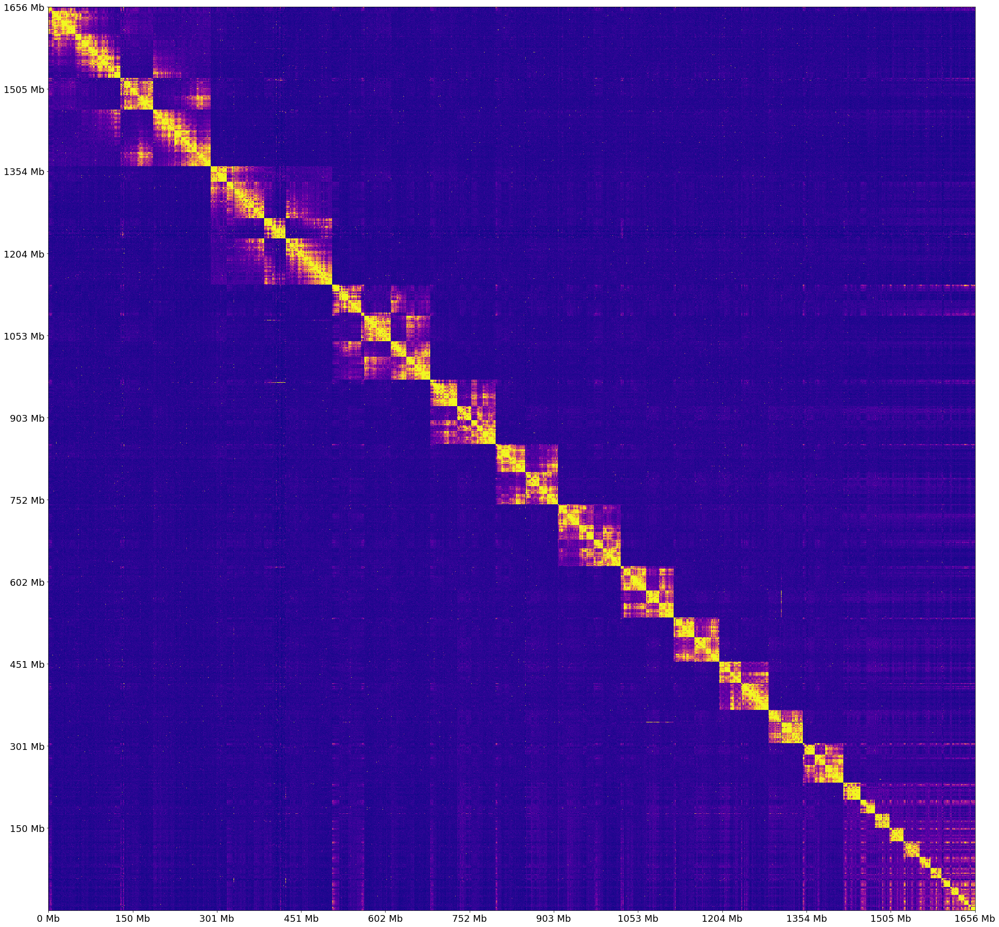

Time to rearrange matrix and plot 19.35533118247986
Total run-time of part 1 = 38.28332495689392
Time to convert matrix 0.08230185508728027
#########################
#########################
Working on iterative 2 state HMMs to identify chromosome boundaries...
#########################
#########################
Input matrix size = 3312 x 3312
HMM round = 1
Input matrix size = 3312 x 582
HMM round = 2
HMM convergence rounds = 2
Cut indices =  [0, 582]
#########################
#########################
Input matrix size = 2730 x 2730
HMM round = 1
Input matrix size = 2730 x 1241
HMM round = 2
Input matrix size = 2730 x 434
HMM round = 3
HMM convergence rounds = 3
Cut indices =  [0, 582, 1016]
#########################
#########################
Input matrix size = 2296 x 2296
HMM round = 1
Input matrix size = 2296 x 15
HMM round = 2
Input matrix size = 2296 x 364
HMM round = 3
Input matrix size = 2296 x 350
HMM round = 4
HMM convergence rounds = 4
Cut indices =  [0, 582, 1016, 1366]
##

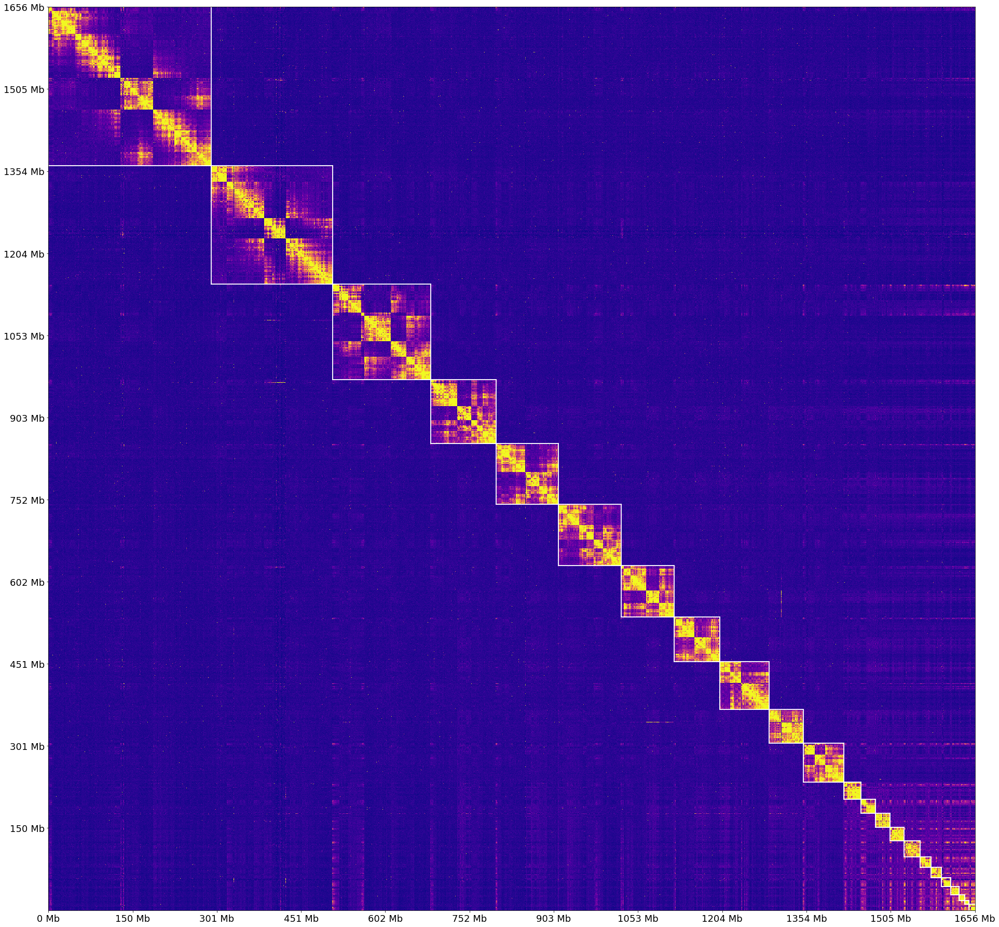

Time to rearrange matrix and plot 18.712976217269897
Total run-time of part 2 = 67.20434975624084
23 chromosomes read in from file
Total run-time of part 3 = 0.01634383201599121
Total run-time = 105.50447392463684
CutIndices = [582, 1016, 1366, 1601, 1823, 2048, 2237, 2400, 2576, 2699, 2843, 2905, 2957, 3008, 3058, 3116, 3155, 3193, 3225, 3255, 3276, 3290]


In [11]:
totalStartTime = time.time()
### Part 1 ############
startTime = time.time()
binList = initiateLoci(hicProBedFile,hicProBiasFile)
adjMat = buildAdjacencyMatrix(hicProMatrixFile,binList)
adjMat,binList = removeRows(adjMat,binList,zeroRows=True,biasVals=False)
adjMat = convertMatrix(adjMat,binList,distance=True,similarity=False)
dendroLabels = [ binList[i].chrom+'_'+str(binList[i].ID) for i in range(0,len(binList)) ]
dendrogram = averageClusterNodes(adjMat,dendroLabels,noPlot=True)
dendrogramLeafOrder_toFile(dendrogram,dendrogramOrderFile)
dendoLeaves = readDengrogramLeavesFromFile(dendrogramOrderFile)
adjMat,binList = reorderMatrix(scipy.asmatrix(adjMat),binList,dendoLeaves['leaves'])
plotContactMap(adjMat,resolution=resolution,highlightChroms=False,showPlot=True,savePlot=avgClusterPlot)
stopTime = time.time()
print("Total run-time of part 1 = "+str(stopTime-startTime))
#######################
### Part 2 ############
startTime = time.time()
adjMat = convertMatrix(adjMat,binList,distance=False,similarity=True)
adjMat = logTransformMatrix(adjMat,logBase=10)
cutIndices = identifyChromosomeGroups(adjMat,binList,minSize=20,modularity=.05,convergenceRounds=8,lookAhead=False,louvainRounds=20)
adjMat = convertMatrix(logTransformMatrix(adjMat,logBase=10,reverse=True),binList,distance=True)
plotContactMap(adjMat,resolution=resolution,highlightChroms=cutIndices,showPlot=True,savePlot=avgClusterPlot_outlined)
writeBinGroupingsToFile(cutIndices,binList,binGroupFile)
stopTime = time.time()
print("Total run-time of part 2 = "+str(stopTime-startTime))
#######################
#######################
### Part 3 ############
startTime = time.time()
fastaSizeDict = readSizeFileToDict(hicProScaffSizeFile)
binGroups = readBinGroupingsFromFile(binGroupFile)
chrGroups = assessChromosomeClustering(binGroups,assessmentFile)
writeChromosomeGroupingsToFile(chrGroups,fastaSizeDict,chromosomeGroupFile)
stopTime = time.time()
print("Total run-time of part 3 = "+str(stopTime-startTime))
###########################
totalStopTime = time.time()
print("Total run-time = "+str(totalStopTime-totalStartTime))
print("CutIndices = "+str(cutIndices))

In [12]:
### Marm 500Kb ###
### minSize=15, modularity=.05 (0.0 also works with minSize=15), convergenceRounds=8,lookAhead=False,louvainRounds=20,logBase=10)
### runTime = 119 seconds
### CutIndices = [582, 1016, 1366, 1601, 1823, 2048, 2237, 2400, 2576, 2699, 2843, 2905, 2957, 3008, 3058, 3116, 3155, 3193, 3225, 3255, 3276, 3290]

### Marm 100Kb ###
### minSize=15, modularity=.05 (0.0 also works with minSize=15), convergenceRounds=8,lookAhead=False,louvainRounds=20,logBase=10)
### runTime = 1744 seconds
### CutIndices = [2821, 4804, 6528, 7673, 8736, 9850, 10770, 11636, 12432, 13037, 13732, 14018, 14262, 14508, 14754, 15021, 15218, 15400, 15542, 15677, 15785, 15857]

### Ino 500Kb ###
### minSize=20, modularity=.05 , convergenceRounds=8,lookAhead=False,louvainRounds=20,logBase=10)
### runTime = 99 seconds
### CutIndices = [284, 720, 953, 1172, 1417, 1623, 1834, 2014, 2166, 2331, 2446, 2581, 2677, 2734, 2781, 2828, 2874, 2924, 2962, 2995, 3022, 3045]

### Ino 100Kb ###
### minSize=20, modularity=.05 , convergenceRounds=8,lookAhead=False,louvainRounds=20,logBase=10)
### runTime = 1870 seconds
### CutIndices = [1410, 3488, 4642, 5705, 6696, 7903, 8955, 9704, 10570, 11382, 11943, 12600, 13056, 13307, 13527, 13753, 13966, 14199, 14366, 14515, 14640, 14739]

### From the looks of it... minSize argument seems to be the most importent of the arguments. You don't even need to use modularity if this is set "correctly"

## Order and orientation of scaffolds pipepline (Part2 of entire pipeline)

**Part1 ) Initiate base level data structures**<br>
1. Dictionary of binIDs to be used in analysis
2. List of bin Objects
3. Adjacency matrix (ie contact map)
4. List of binIDs/scaffolds belonging to each chromosome<br>

**Part2 ) Assign genomic loci (bins) to chromosome groups via HMM and modularity**<br>
1. Order and orient all scaffolds within a chromosome for all chromosomes<br>

**Part3) Assign scaffolds to chromosomes and rename chromosome groups based on size**<br>
1. Plot genome wide results
2. write out ordering / orientation results for each chromosome

Genomic loci found	3312
Adjacency matrix initiated
Adding edges...
Edges processed 1000000
Edges processed 2000000
Edges processed 3000000
Edges processed 4000000
Edges processed 5000000
Edges added to adjacency matrix	5374137
Rows in adjacency matrix 3312
Chromosomes found 23
Nodes found 3312
#####################
#####################
Working on Chr_1...
Scaffolds to order for this chromosome 15
Initial permutations to test 23040...
Time for 10000 calculations = 9.053539037704468
Time for 20000 calculations = 8.956040143966675
BestCost at the end of first two steps 3.406344555351835
Working on round 1 of final step...
Working on round 2 of final step...
Sliding window conversion after 2 rounds
Best cost at the end of the final step = 3.406448176480646
Final ordering...
Scpiz6a_1473 +
Scpiz6a_2465 +
Scpiz6a_415 +
Scpiz6a_185 +
Scpiz6a_47 +
Scpiz6a_65 -
Scpiz6a_72 -
Scpiz6a_17.2 -
Scpiz6a_17 -
Scpiz6a_11.1 -
Scpiz6a_11 -
Scpiz6a_27 -
Scpiz6a_2672 +
Scpiz6a_122 +
Scpiz6a_1590 -


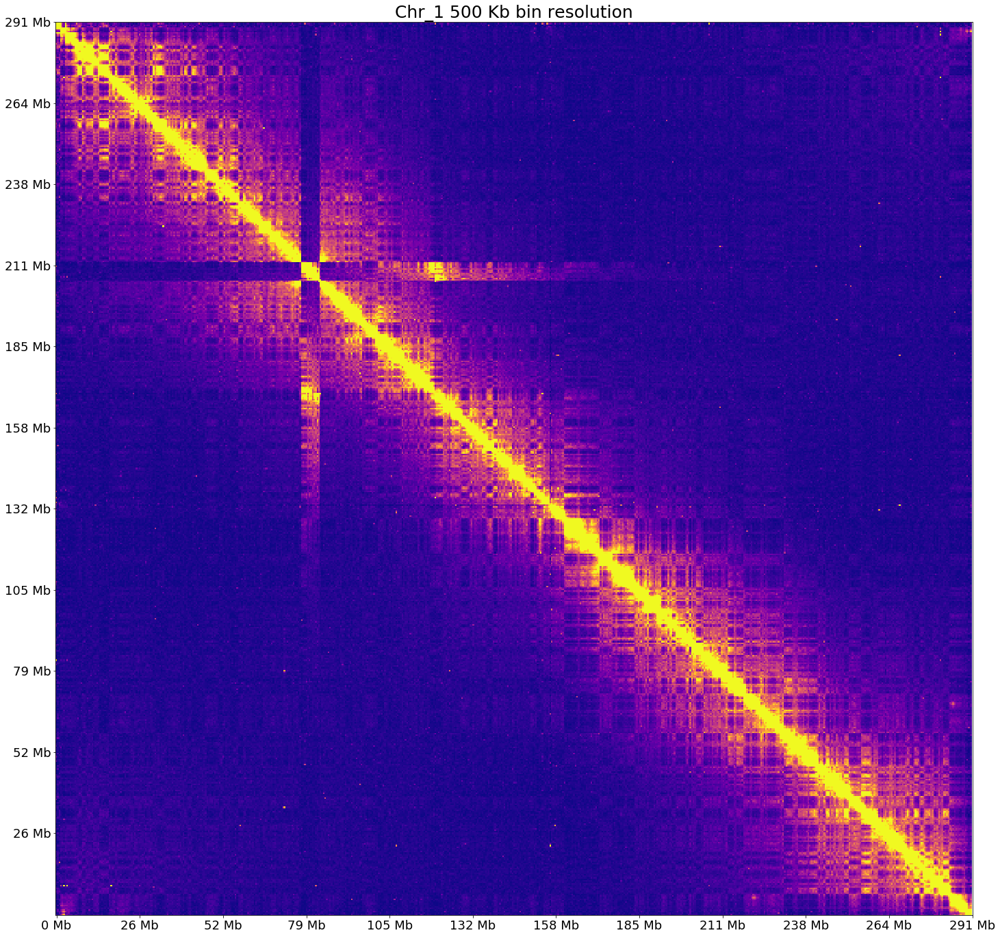

Time to rearrange matrix and plot 1.3449420928955078
#####################
#####################
Working on Chr_2...
Scaffolds to order for this chromosome 53
Initial permutations to test 23040...
Time for 10000 calculations = 4.9934327602386475
Time for 20000 calculations = 5.001320838928223
BestCost at the end of first two steps 3.335051047352146
Working on round 1 of final step...
Working on round 2 of final step...
Working on round 3 of final step...
Sliding window conversion after 3 rounds
Best cost at the end of the final step = 3.3412170738218756
Final ordering...
Scpiz6a_2349 +
Scpiz6a_435.1 +
Scpiz6a_435 +
Scpiz6a_428 +
Scpiz6a_428.1 +
Scpiz6a_231 +
Scpiz6a_447 +
Scpiz6a_1511 +
Scpiz6a_2735 +
Scpiz6a_610 +
Scpiz6a_627 +
Scpiz6a_408 +
Scpiz6a_1049 +
Scpiz6a_656 +
Scpiz6a_455 +
Scpiz6a_383 +
Scpiz6a_960 -
Scpiz6a_295 +
Scpiz6a_746 -
Scpiz6a_746.1 +
Scpiz6a_21 -
Scpiz6a_289 -
Scpiz6a_126.1 +
Scpiz6a_126 +
Scpiz6a_68 -
Scpiz6a_328 -
Scpiz6a_53.1 -
Scpiz6a_53 -
Scpiz6a_105 -
Scpiz6

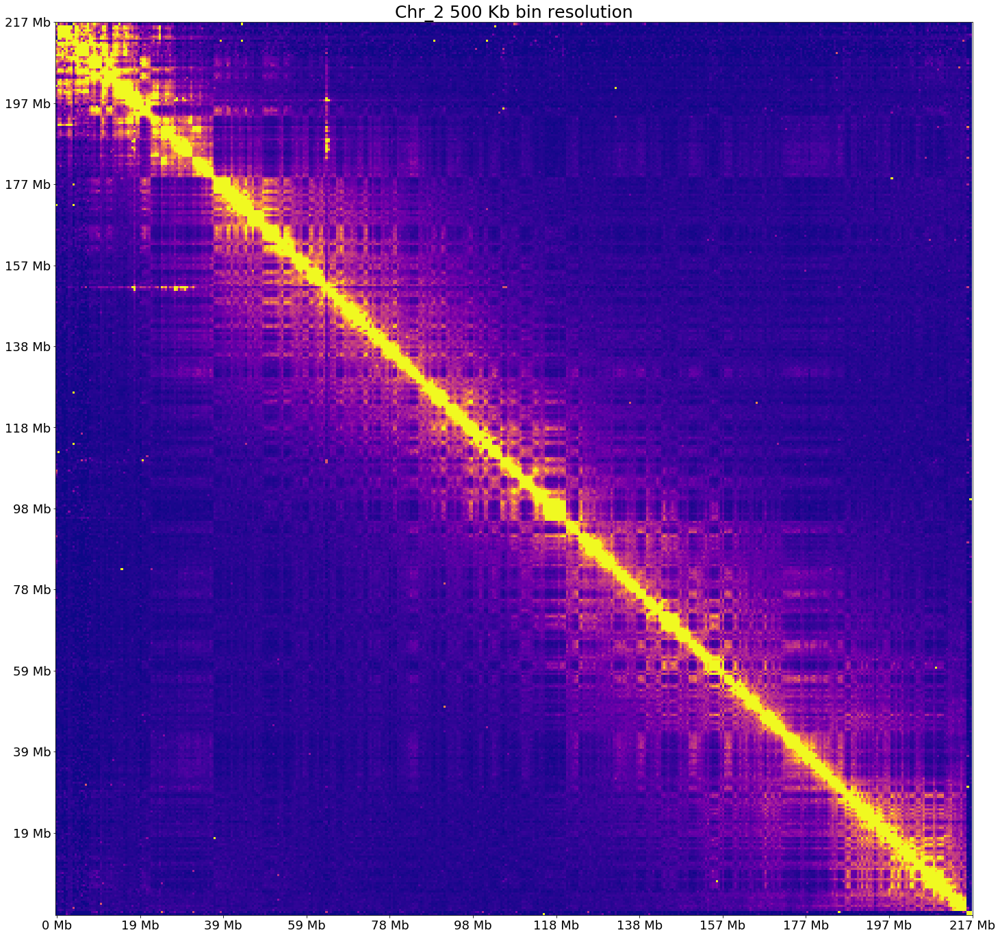

Time to rearrange matrix and plot 0.9333469867706299
#####################
#####################
Working on Chr_3...
Scaffolds to order for this chromosome 8
Initial permutations to test 23040...
Time for 10000 calculations = 4.995018005371094
Time for 20000 calculations = 5.007428884506226
BestCost at the end of first two steps 3.2340771964824397
Working on round 1 of final step...
Working on round 2 of final step...
Sliding window conversion after 2 rounds
Best cost at the end of the final step = 3.234077196482443
Final ordering...
Scpiz6a_39 -
Scpiz6a_120 -
Scpiz6a_73 -
Scpiz6a_52 -
Scpiz6a_86 -
Scpiz6a_255 +
Scpiz6a_45 -
Scpiz6a_1742 -


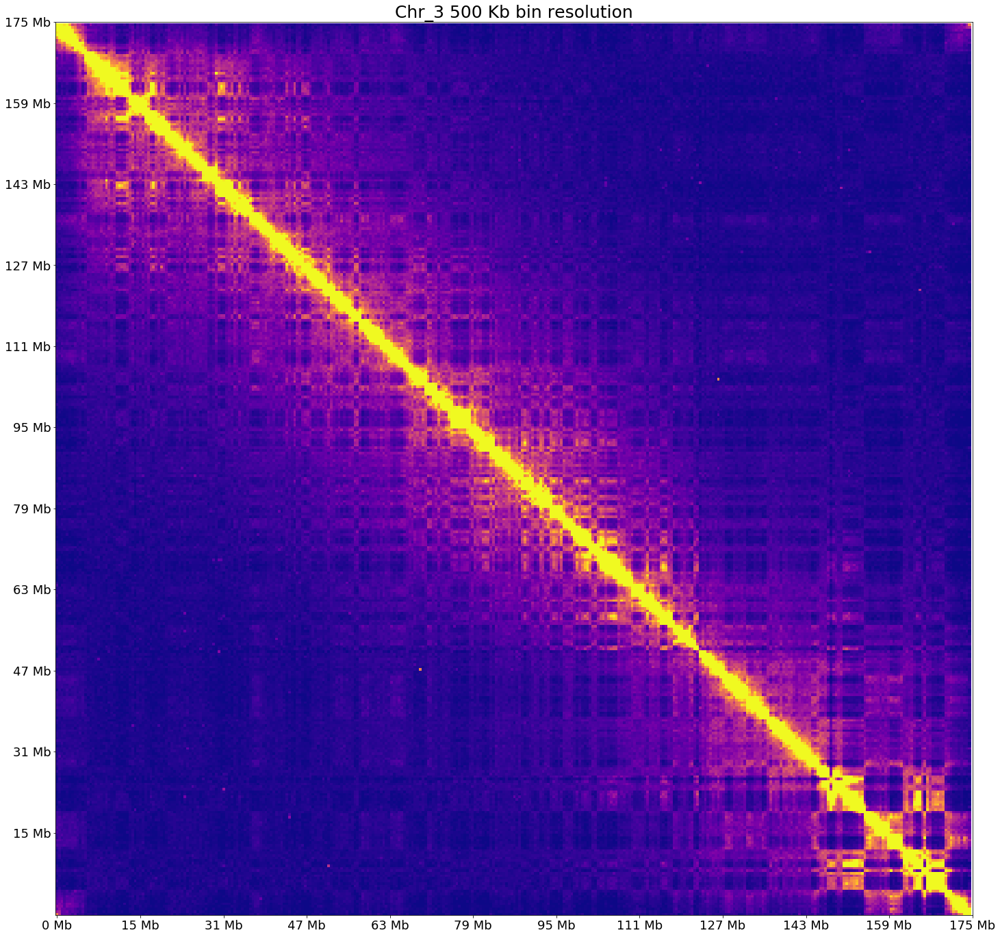

Time to rearrange matrix and plot 0.7608089447021484
#####################
#####################
Working on Chr_4...
Scaffolds to order for this chromosome 4
Initial permutations to test 192...
BestCost at the end of first two steps 3.082209560340373
Final ordering...
Scpiz6a_29 +
Scpiz6a_49 +
Scpiz6a_263 +
Scpiz6a_1172 -


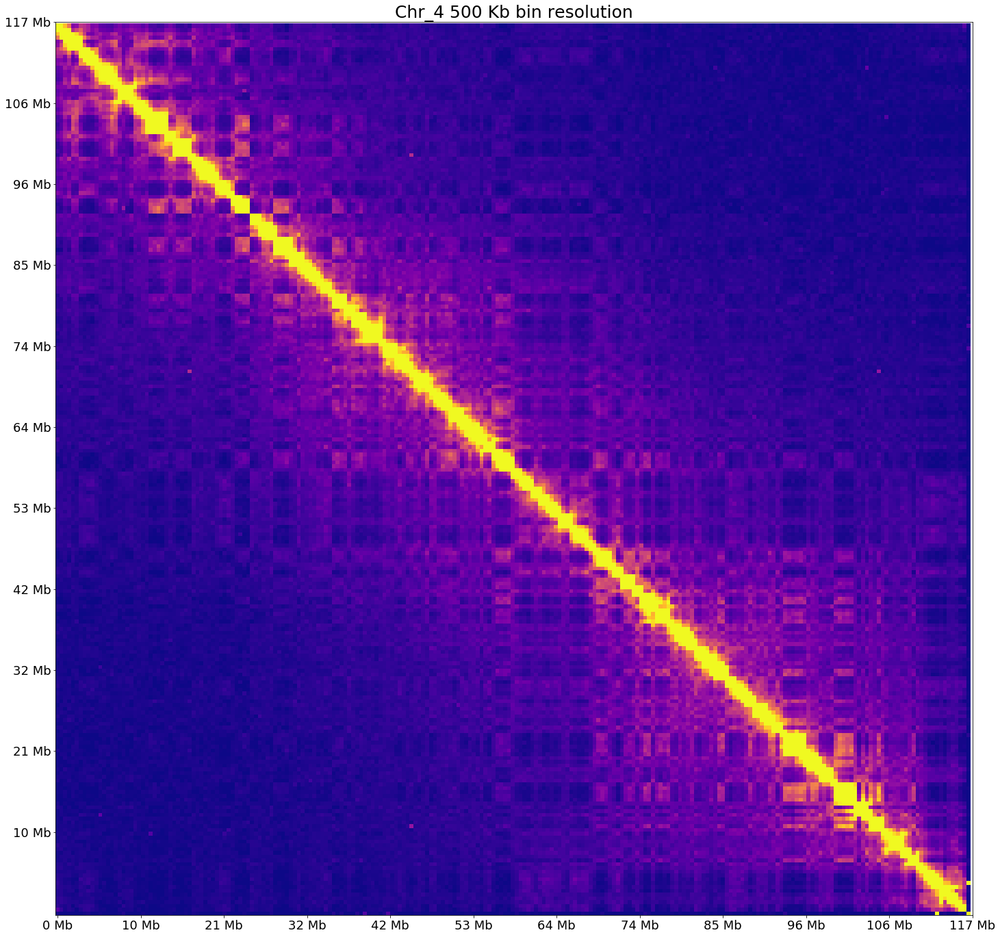

Time to rearrange matrix and plot 0.5964150428771973
#####################
#####################
Working on Chr_5...
Scaffolds to order for this chromosome 2
Initial permutations to test 4...
BestCost at the end of first two steps 3.0452422202946043
Final ordering...
Scpiz6a_26 +
Scpiz6a_43 +


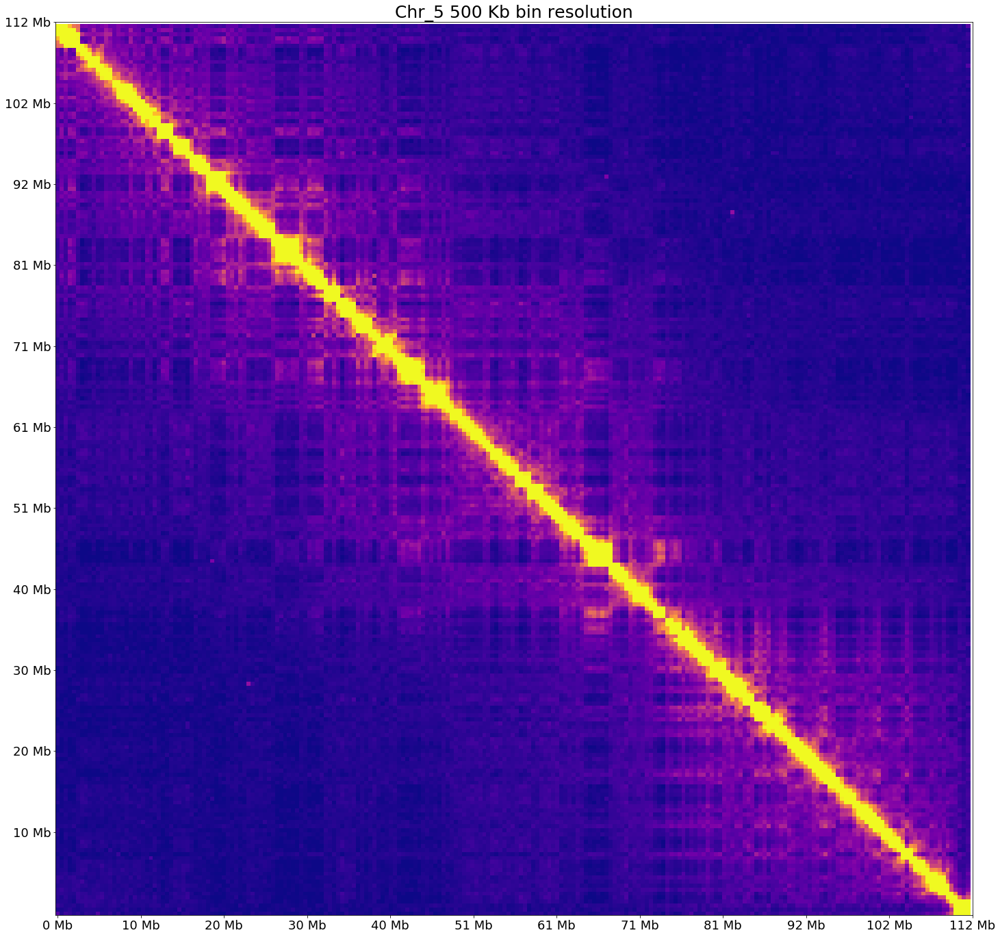

Time to rearrange matrix and plot 0.5787360668182373
#####################
#####################
Working on Chr_6...
Scaffolds to order for this chromosome 11
Initial permutations to test 23040...
Time for 10000 calculations = 2.188297986984253
Time for 20000 calculations = 2.1777522563934326
BestCost at the end of first two steps 3.083796346466241
Working on round 1 of final step...
Working on round 2 of final step...
Sliding window conversion after 2 rounds
Best cost at the end of the final step = 3.0837963464662437
Final ordering...
Scpiz6a_147 +
Scpiz6a_44.1 -
Scpiz6a_44 -
Scpiz6a_707 -
Scpiz6a_253 +
Scpiz6a_382 +
Scpiz6a_423.1 -
Scpiz6a_423 -
Scpiz6a_391.1 -
Scpiz6a_391 +
Scpiz6a_132 +


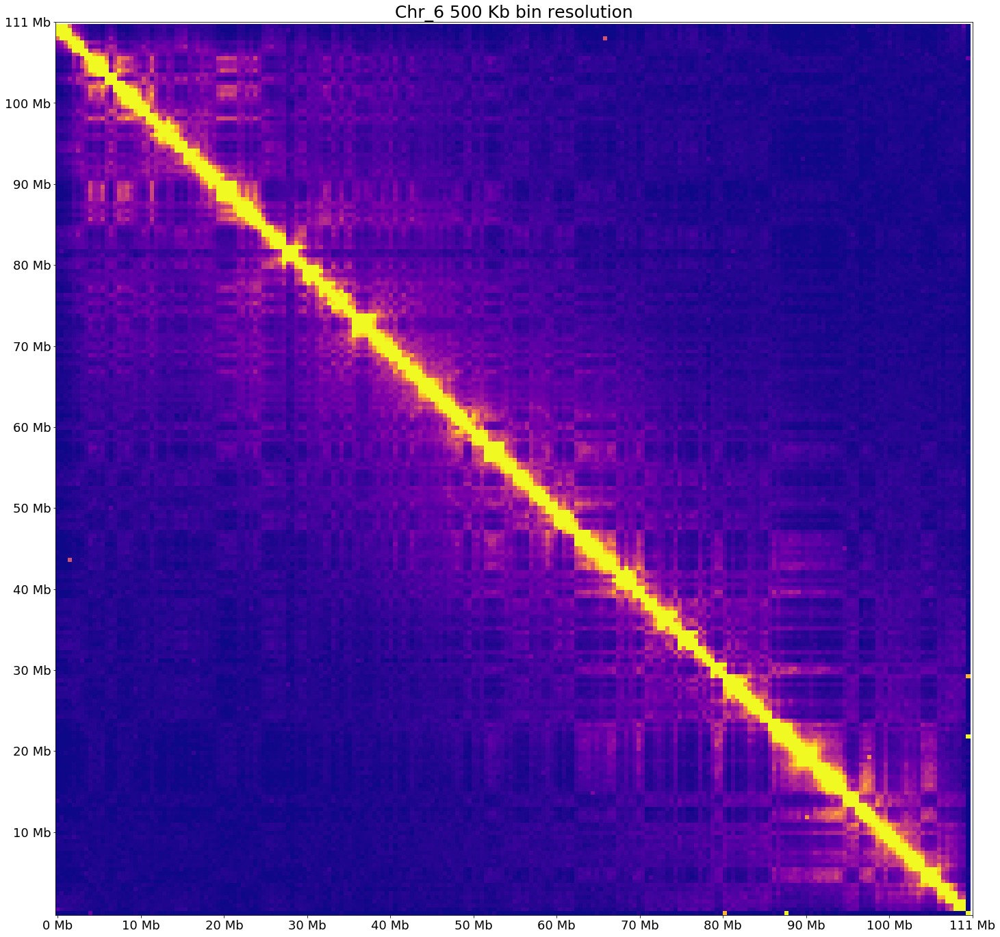

Time to rearrange matrix and plot 0.5695569515228271
#####################
#####################
Working on Chr_7...
Scaffolds to order for this chromosome 6
Initial permutations to test 23040...
Time for 10000 calculations = 1.8455758094787598
Time for 20000 calculations = 1.8433079719543457
BestCost at the end of first two steps 3.0041937605430626
Final ordering...
Scpiz6a_75 +
Scpiz6a_291 +
Scpiz6a_28 +
Scpiz6a_1492 +
Scpiz6a_31 +
Scpiz6a_99 +


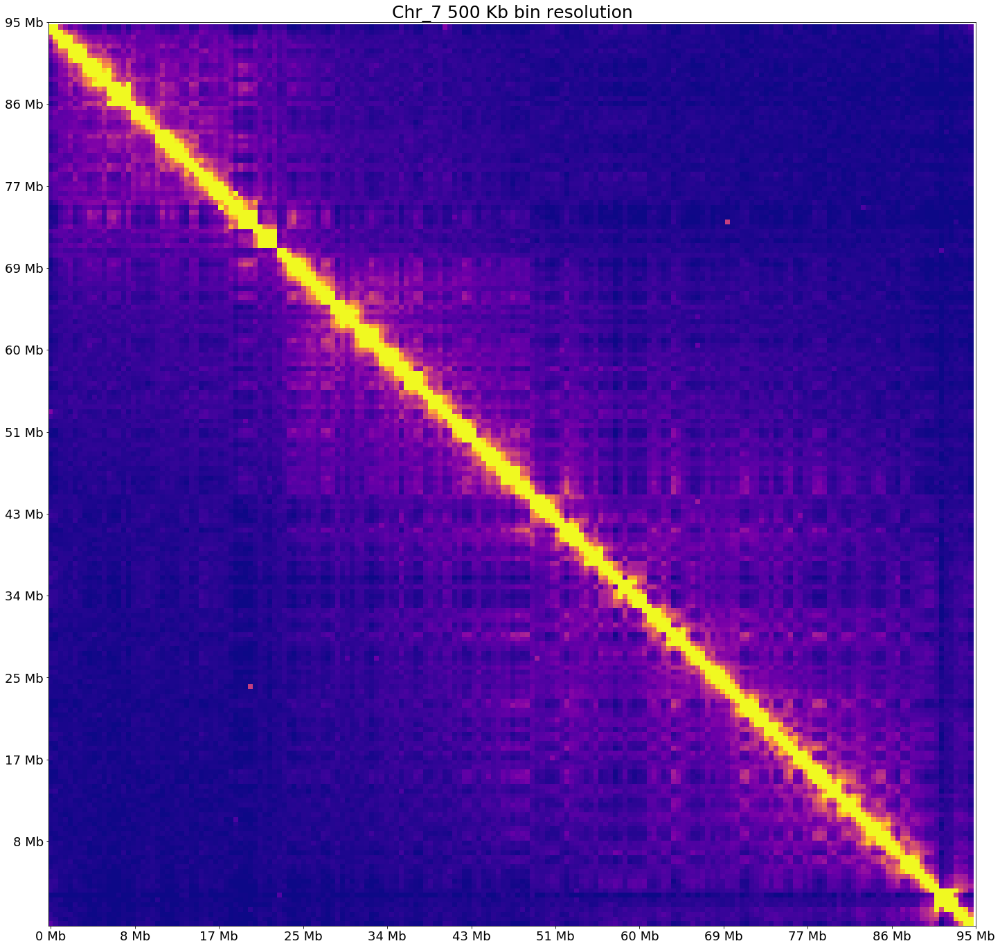

Time to rearrange matrix and plot 0.5461788177490234
#####################
#####################
Working on Chr_8...
Scaffolds to order for this chromosome 3
Initial permutations to test 24...
BestCost at the end of first two steps 2.9885734564887625
Final ordering...
Scpiz6a_55 +
Scpiz6a_55.1 +
Scpiz6a_55.2 +


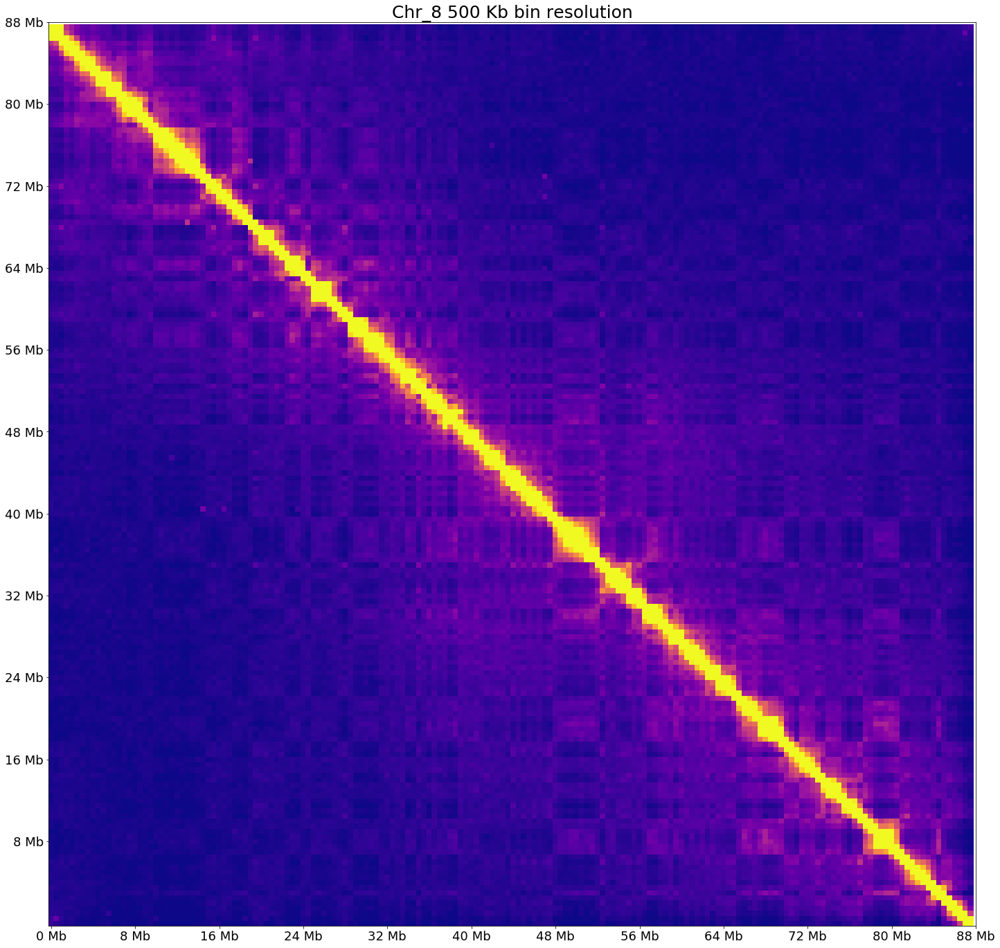

Time to rearrange matrix and plot 0.5333471298217773
#####################
#####################
Working on Chr_9...
Scaffolds to order for this chromosome 2
Initial permutations to test 4...
BestCost at the end of first two steps 2.907372685635426
Final ordering...
Scpiz6a_146 +
Scpiz6a_113 -


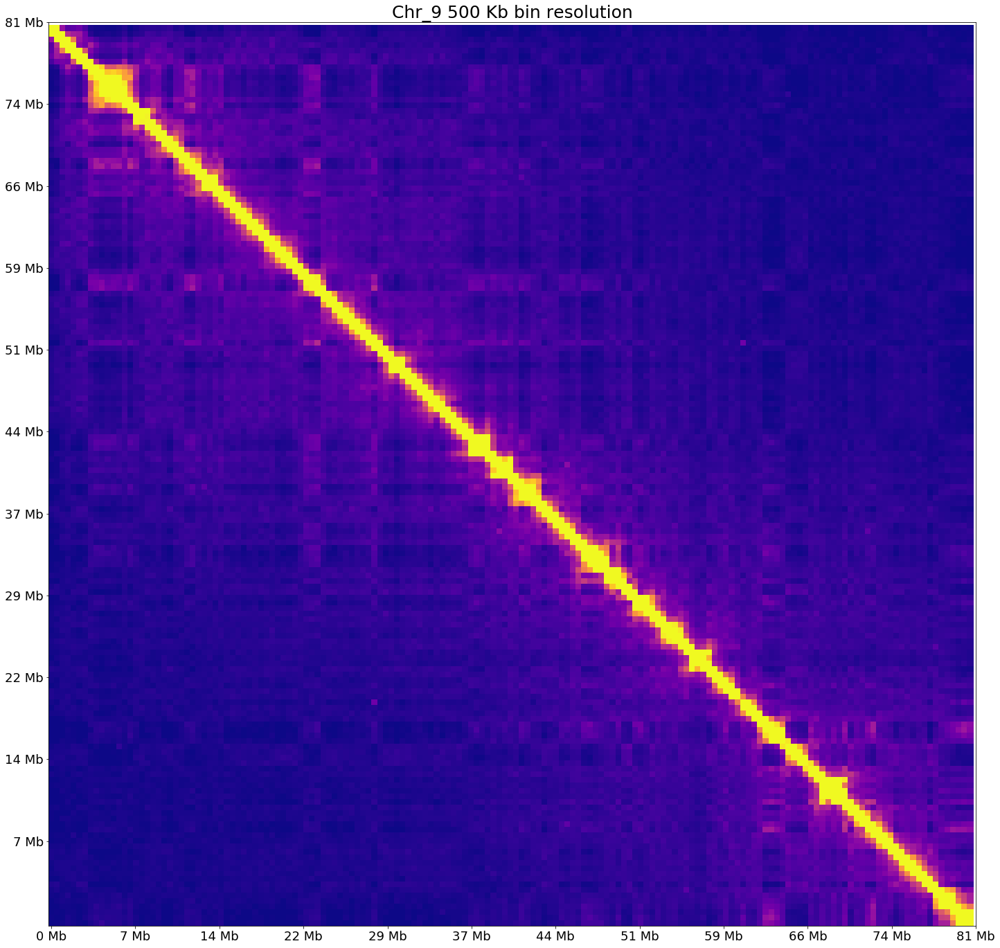

Time to rearrange matrix and plot 0.5202310085296631
#####################
#####################
Working on Chr_10...
Scaffolds to order for this chromosome 7
Initial permutations to test 23040...
Time for 10000 calculations = 1.2474391460418701
Time for 20000 calculations = 1.2370970249176025
BestCost at the end of first two steps 2.9121731214557793
Working on round 1 of final step...
Working on round 2 of final step...
Sliding window conversion after 2 rounds
Best cost at the end of the final step = 2.91217312145578
Final ordering...
Scpiz6a_30.1 -
Scpiz6a_1376 -
Scpiz6a_970 +
Scpiz6a_396 -
Scpiz6a_2423 -
Scpiz6a_115 -
Scpiz6a_115.1 -


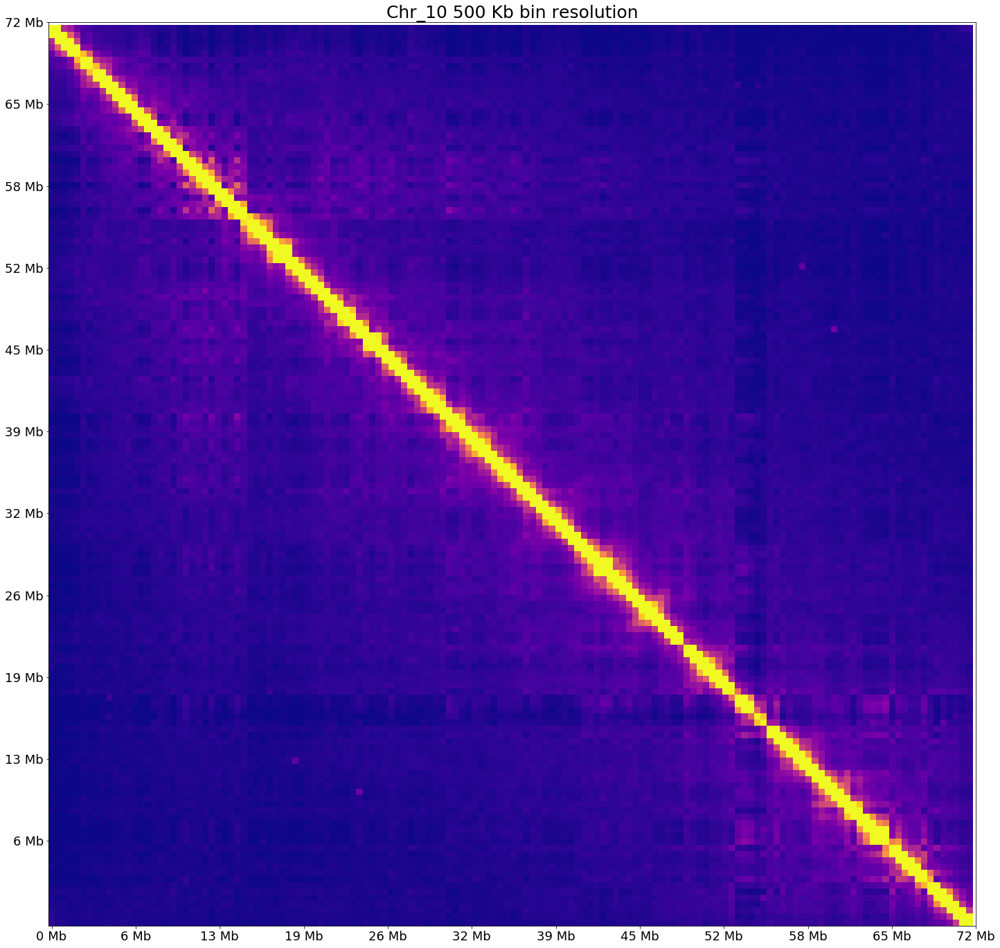

Time to rearrange matrix and plot 0.49944114685058594
#####################
#####################
Working on Chr_11...
Scaffolds to order for this chromosome 2
Initial permutations to test 4...
BestCost at the end of first two steps 2.801672581296255
Final ordering...
Scpiz6a_1 -
Scpiz6a_148 +


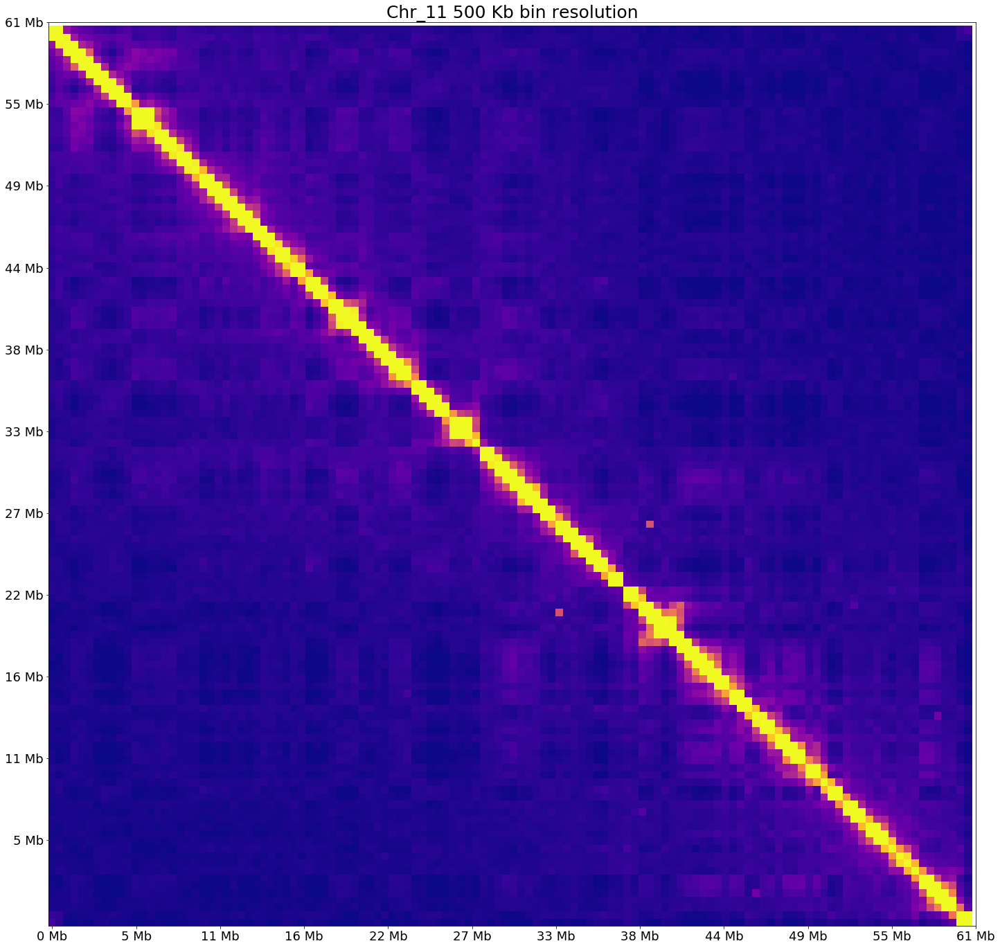

Time to rearrange matrix and plot 0.48360586166381836
#####################
#####################
Working on Chr_12...
Scaffolds to order for this chromosome 8
Initial permutations to test 23040...
Time for 10000 calculations = 0.43306493759155273
Time for 20000 calculations = 0.43631529808044434
BestCost at the end of first two steps 2.602916831861209
Working on round 1 of final step...
Working on round 2 of final step...
Sliding window conversion after 2 rounds
Best cost at the end of the final step = 2.6029168318612093
Final ordering...
Scpiz6a_152.1 +
Scpiz6a_16 +
Scpiz6a_642 +
Scpiz6a_1276 -
Scpiz6a_597 -
Scpiz6a_173 -
Scpiz6a_1476 +
Scpiz6a_1005 +


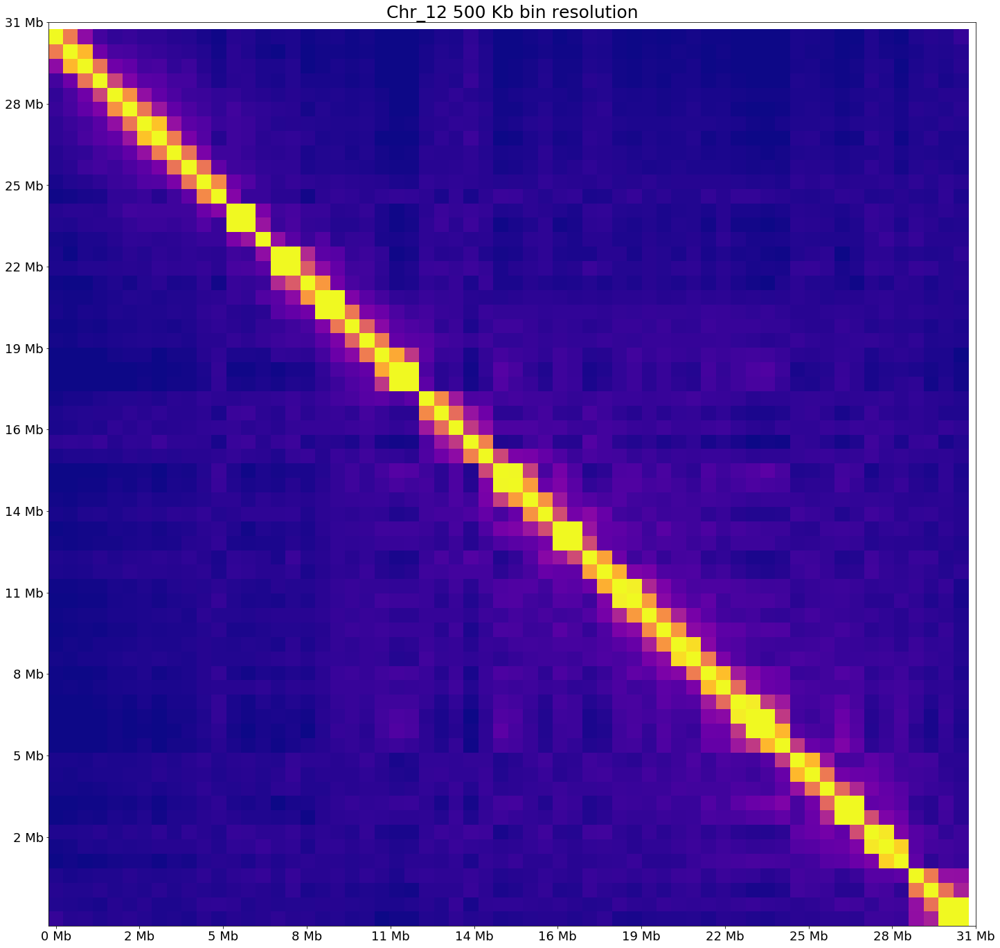

Time to rearrange matrix and plot 0.44907188415527344
#####################
#####################
Working on Chr_13...
Scaffolds to order for this chromosome 6
Initial permutations to test 23040...
Time for 10000 calculations = 0.4276700019836426
Time for 20000 calculations = 0.42557501792907715
BestCost at the end of first two steps 2.7238864101854032
Final ordering...
Scpiz6a_66 +
Scpiz6a_3382 +
Scpiz6a_19 -
Scpiz6a_964 -
Scpiz6a_18 -
Scpiz6a_18.1 -


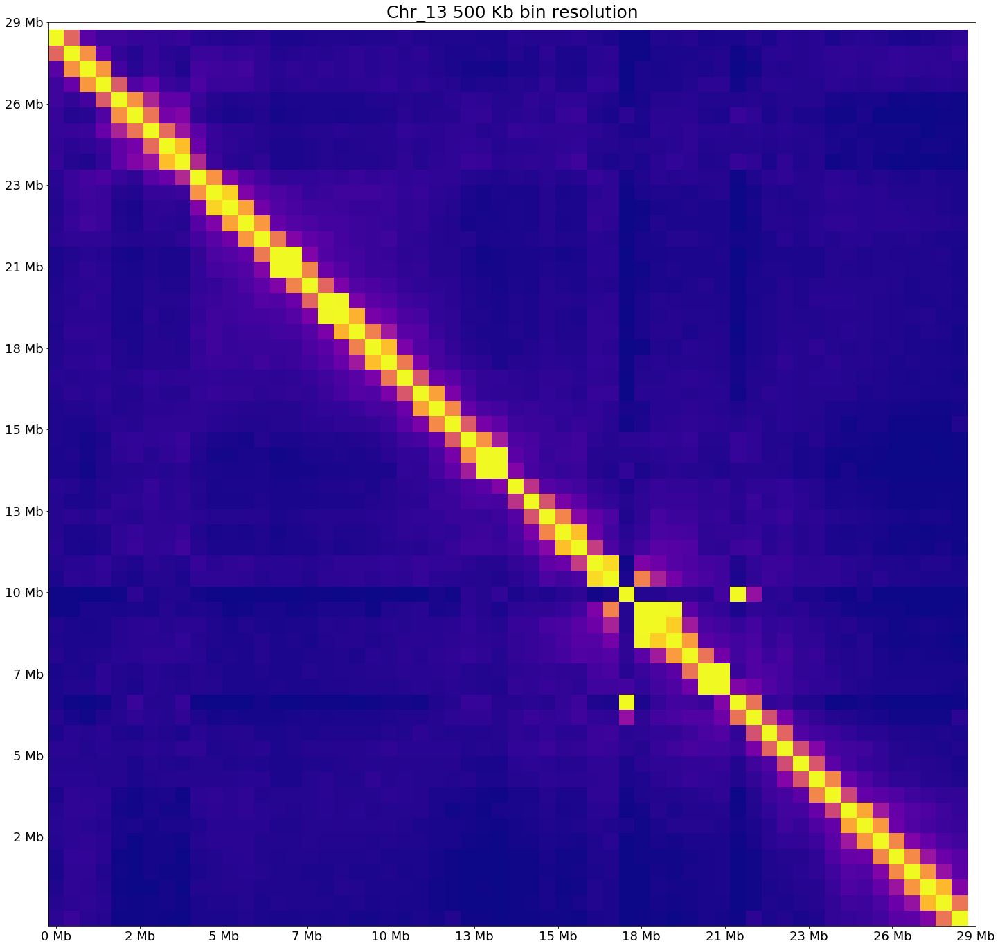

Time to rearrange matrix and plot 0.4454219341278076
#####################
#####################
Working on Chr_14...
Scaffolds to order for this chromosome 3
Initial permutations to test 24...
BestCost at the end of first two steps 2.7372724230960386
Final ordering...
Scpiz6a_201 +
Scpiz6a_696 +
Scpiz6a_2124 +


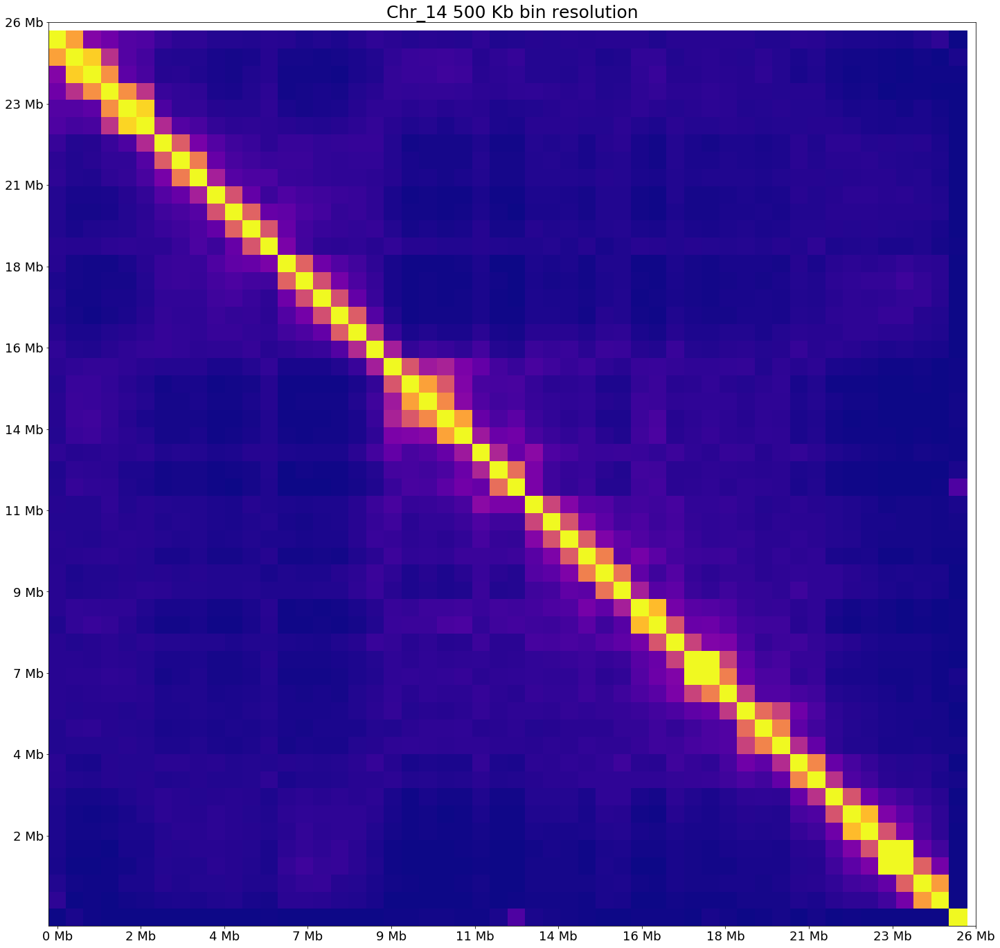

Time to rearrange matrix and plot 0.4418001174926758
#####################
#####################
Working on Chr_15...
Scaffolds to order for this chromosome 5
Initial permutations to test 1920...
BestCost at the end of first two steps 2.5709482773674663
Final ordering...
Scpiz6a_593 -
Scpiz6a_462 -
Scpiz6a_1453 -
Scpiz6a_2065 -
Scpiz6a_264 +


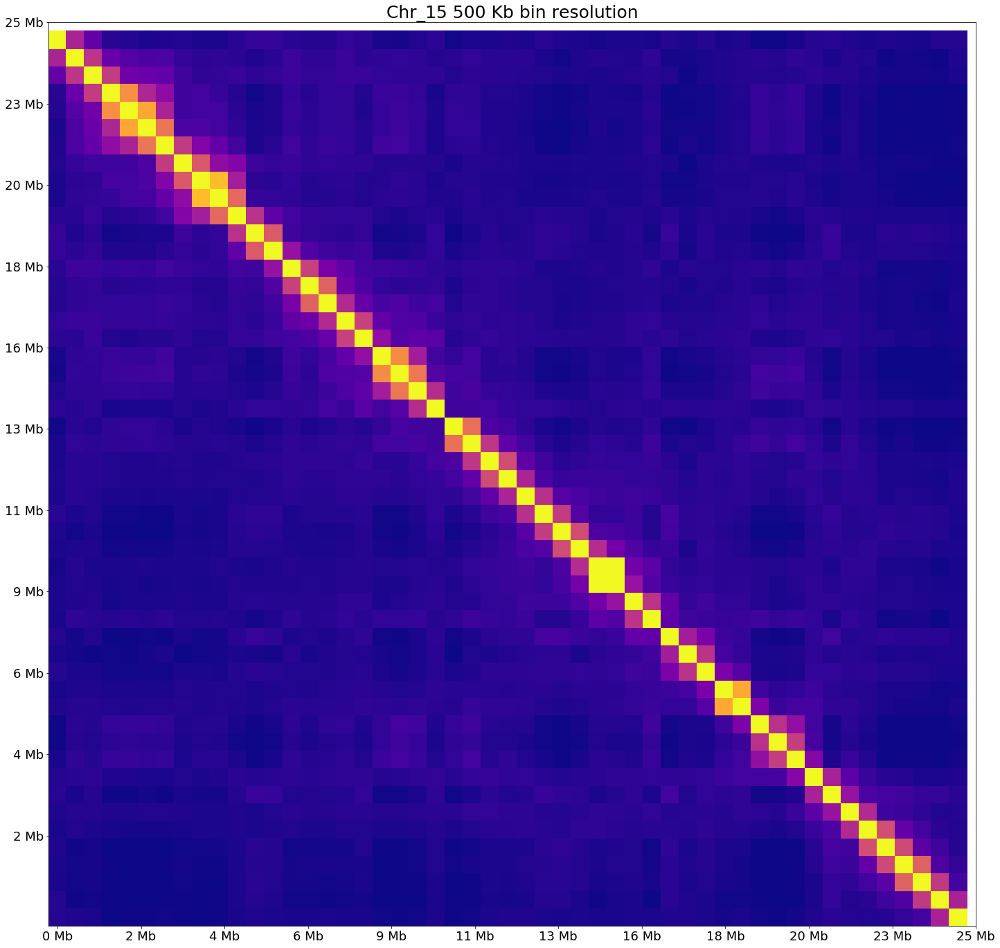

Time to rearrange matrix and plot 0.44051599502563477
#####################
#####################
Working on Chr_16...
Scaffolds to order for this chromosome 2
Initial permutations to test 4...
BestCost at the end of first two steps 2.5967380570074523
Final ordering...
Scpiz6a_170.1 -
Scpiz6a_378 +


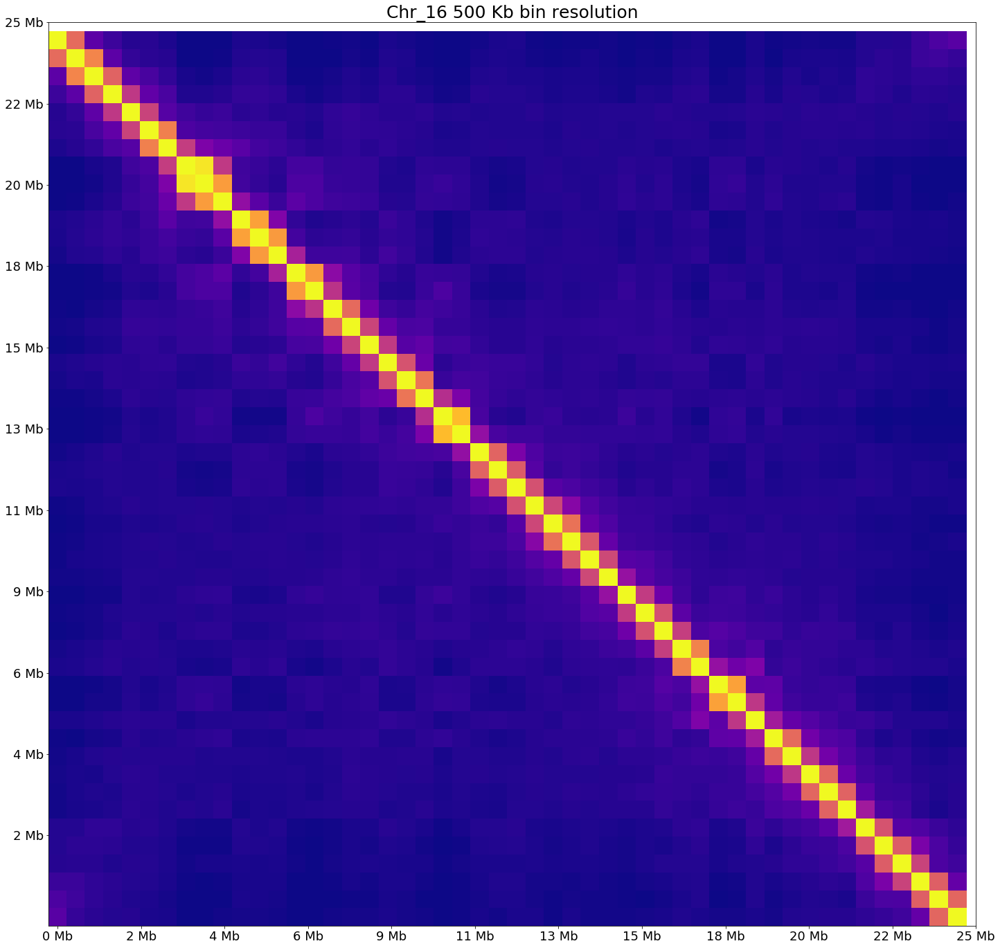

Time to rearrange matrix and plot 0.44557809829711914
#####################
#####################
Working on Chr_17...
Scaffolds to order for this chromosome 3
Initial permutations to test 24...
BestCost at the end of first two steps 2.633658275220253
Final ordering...
Scpiz6a_22 -
Scpiz6a_368 -
Scpiz6a_150 +


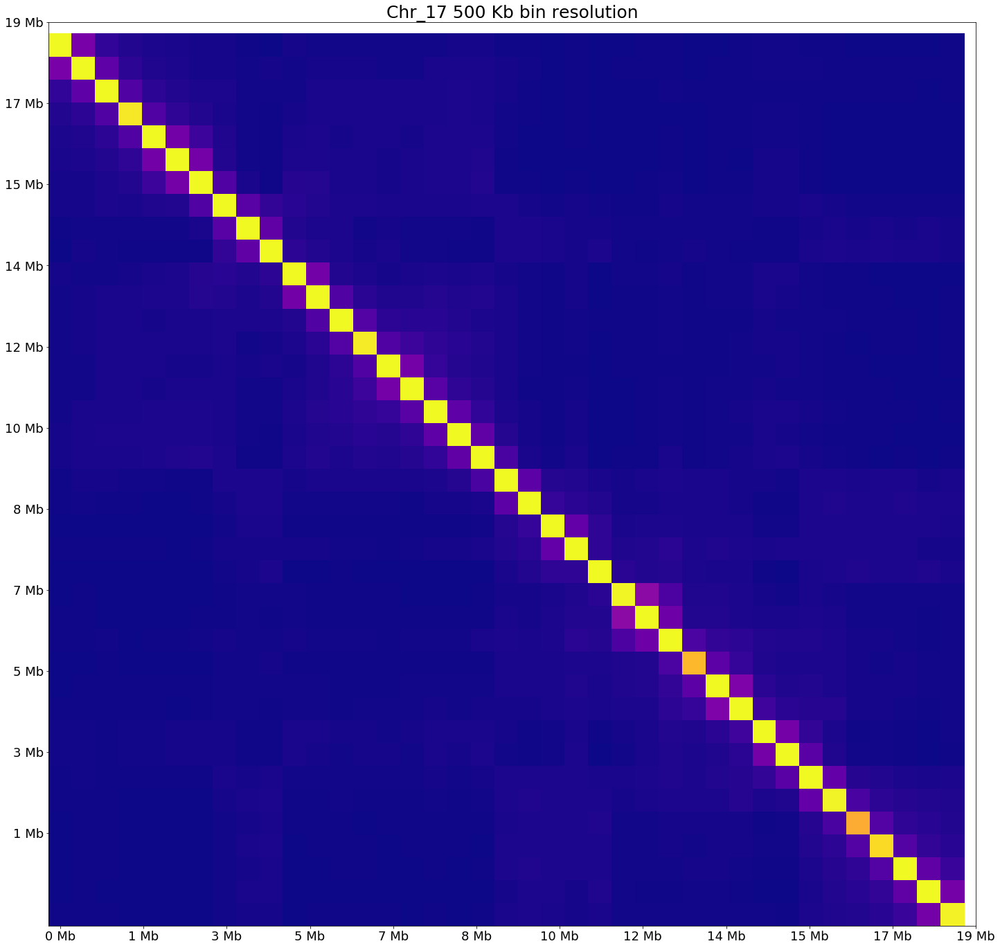

Time to rearrange matrix and plot 0.4344148635864258
#####################
#####################
Working on Chr_18...
Scaffolds to order for this chromosome 4
Initial permutations to test 192...
BestCost at the end of first two steps 2.626673509232936
Final ordering...
Scpiz6a_745 -
Scpiz6a_81.1 -
Scpiz6a_119 +
Scpiz6a_565 +


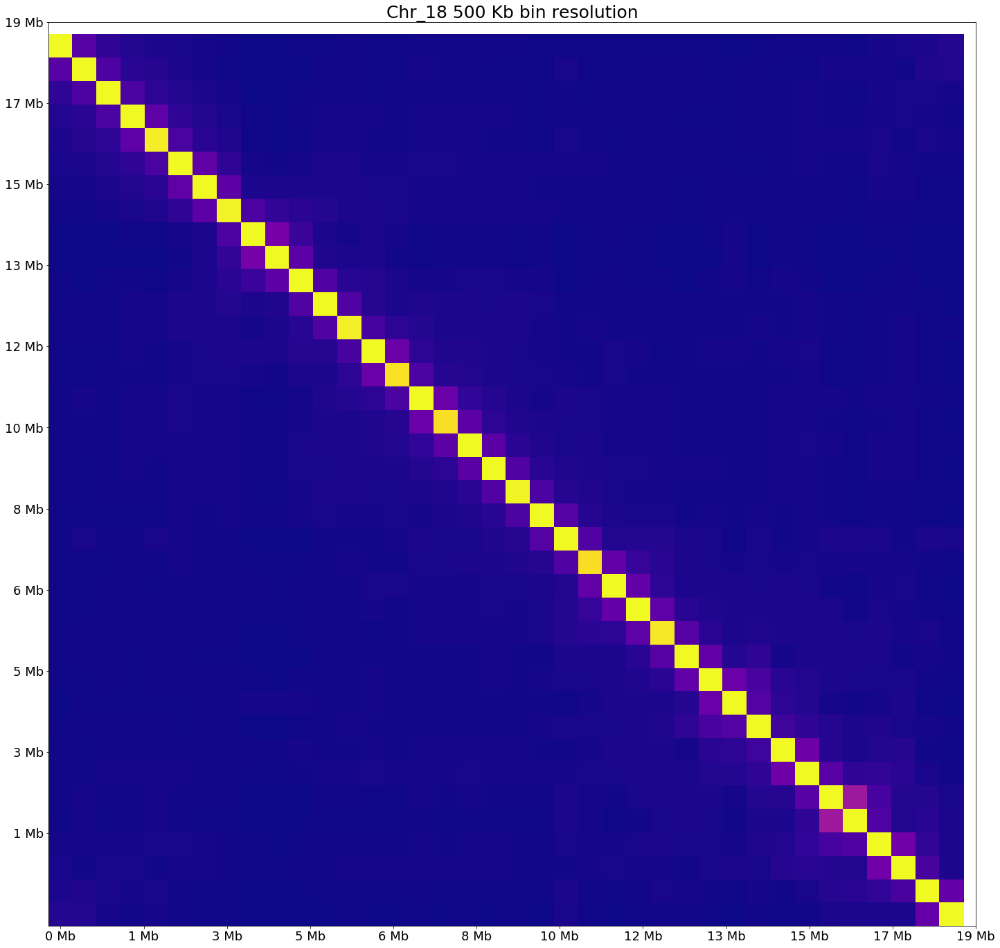

Time to rearrange matrix and plot 0.4384458065032959
#####################
#####################
Working on Chr_19...
Scaffolds to order for this chromosome 8
Initial permutations to test 23040...
Time for 10000 calculations = 0.28572702407836914
Time for 20000 calculations = 0.2883472442626953
BestCost at the end of first two steps 2.7219825612807695
Working on round 1 of final step...
Sliding window conversion after 1 rounds
Best cost at the end of the final step = 2.7219825612807695
Final ordering...
Scpiz6a_30 +
Scpiz6a_87 -
Scpiz6a_1185 -
Scpiz6a_666 -
Scpiz6a_5.1 -
Scpiz6a_5 -
Scpiz6a_177.1 +
Scpiz6a_177 +


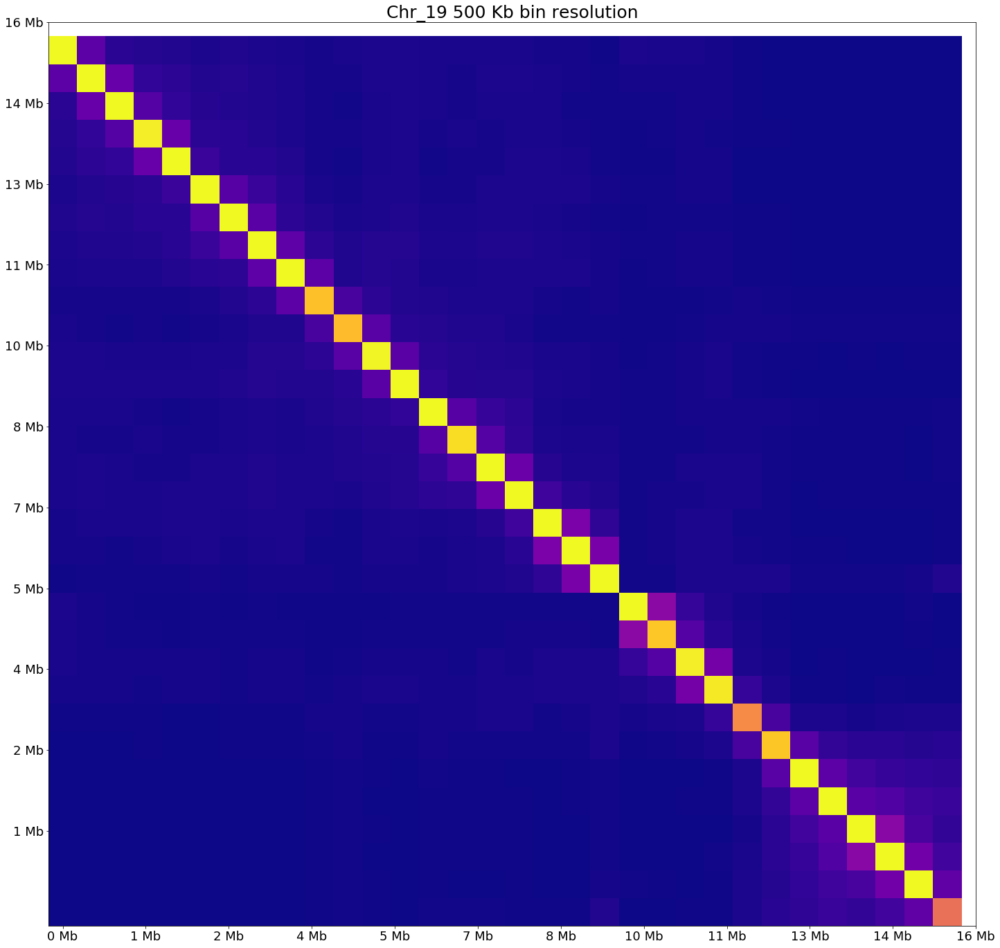

Time to rearrange matrix and plot 0.4304969310760498
#####################
#####################
Working on Chr_20...
Scaffolds to order for this chromosome 2
Initial permutations to test 4...
BestCost at the end of first two steps 2.541587181360281
Final ordering...
Scpiz6a_23 +
Scpiz6a_23.1 +


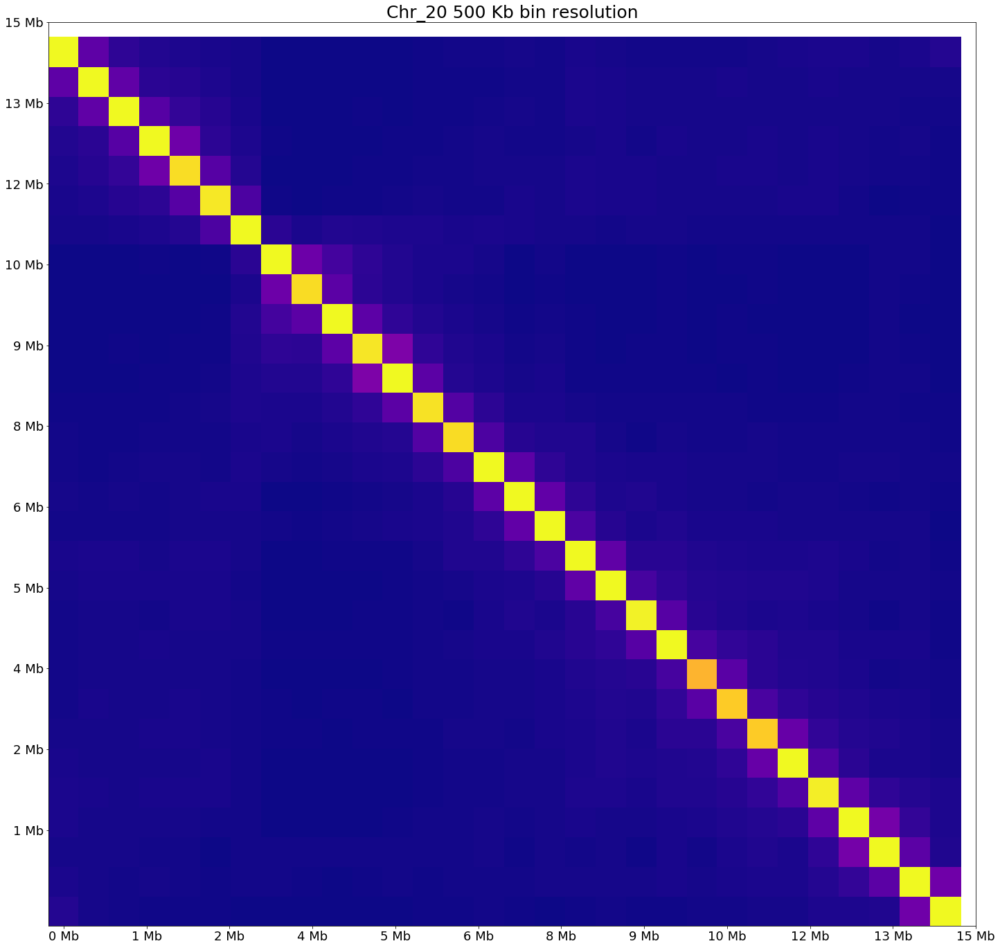

Time to rearrange matrix and plot 0.4321591854095459
#####################
#####################
Working on Chr_21...
Scaffolds to order for this chromosome 2
Initial permutations to test 4...
BestCost at the end of first two steps 2.526755456700627
Final ordering...
Scpiz6a_232 -
Scpiz6a_434 -


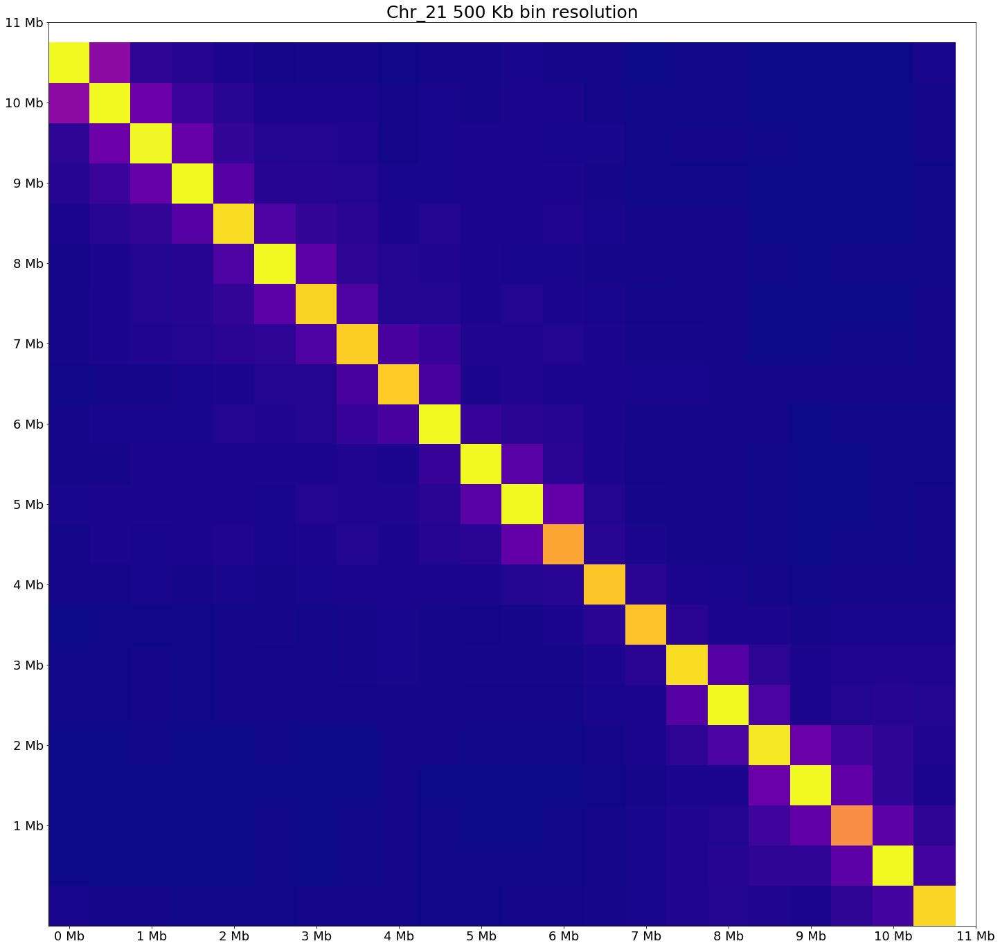

Time to rearrange matrix and plot 0.42711400985717773
#####################
#####################
Working on Chr_22...
Scaffolds to order for this chromosome 2
Initial permutations to test 4...
BestCost at the end of first two steps 2.3370378033658725
Final ordering...
Scpiz6a_34 -
Scpiz6a_782 -


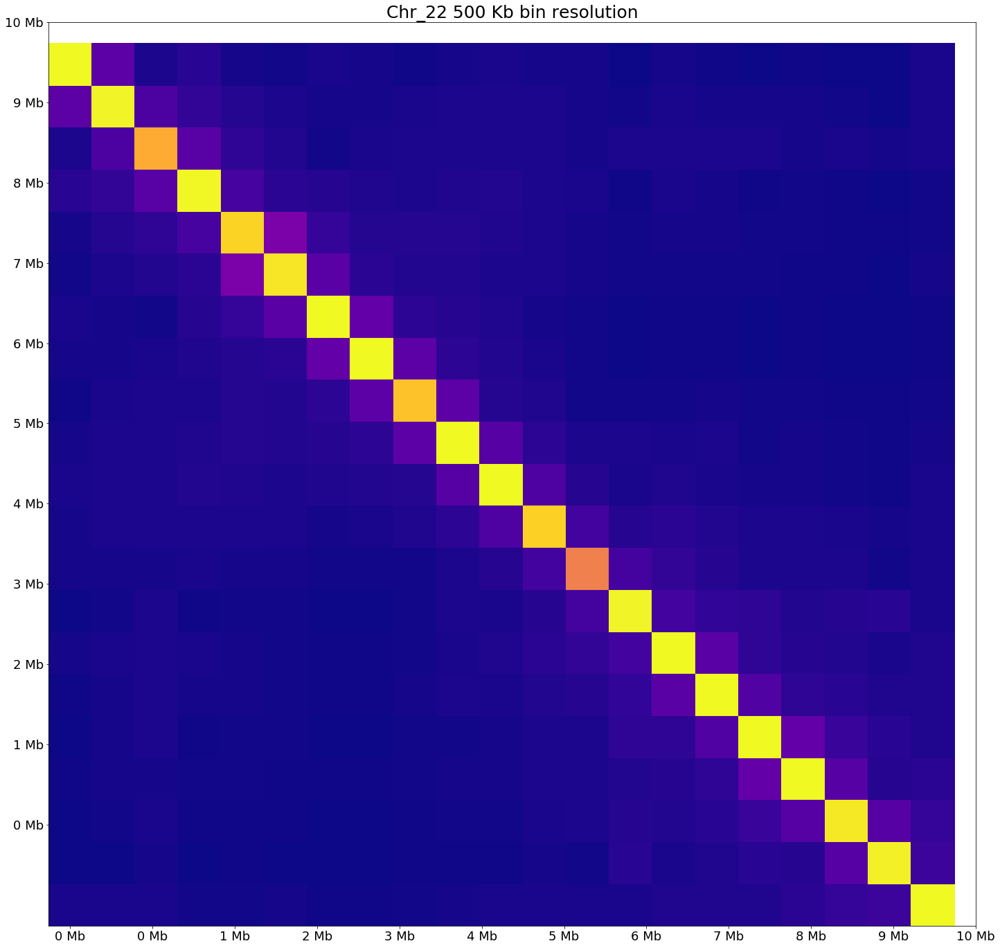

Time to rearrange matrix and plot 0.42677903175354004
#####################
#####################
Working on Chr_23...
Scaffolds to order for this chromosome 2
Initial permutations to test 4...
BestCost at the end of first two steps 2.157436023963305
Final ordering...
Scpiz6a_136.1 -
Scpiz6a_136 -


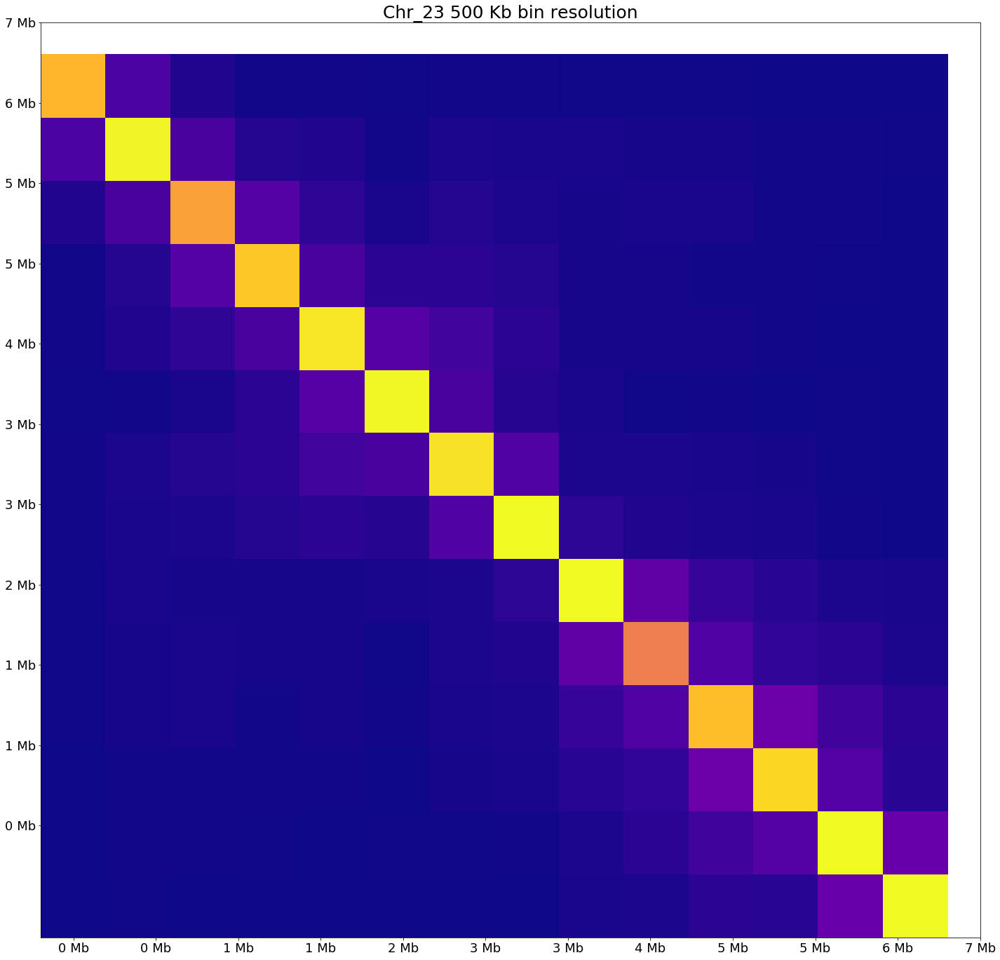

Time to rearrange matrix and plot 0.42652416229248047
RunTime for total genome with plotting and saving .pngs = 361.32872104644775


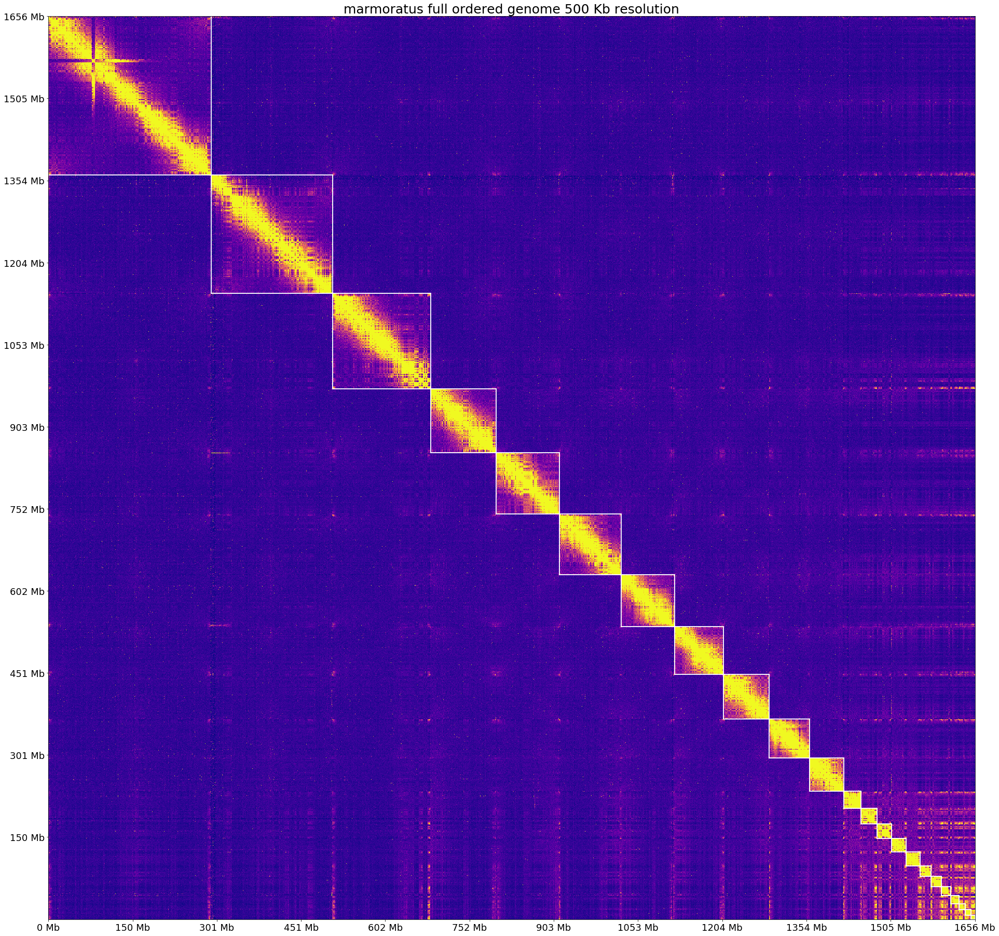

Time to rearrange matrix and plot 19.048272132873535


TypeError: 'Scaffold' object is not subscriptable

In [13]:
startTime = time.time()
### Part1 ##########################
### Initiate our data structures ###
binDict = readGroupingsToValidBins(chromosomeGroupFile) ### Generate a dictionary of { binIDs:'' } to use in the analysis based on assignment from the first step
binList = initiateLoci(hicProBedFile,hicProBiasFile,binID_dict=binDict) ### Initiate our list of Bin objects (only including those that are in binDict)
adjMat = buildAdjacencyMatrix(hicProMatrixFile,binList) ### Build our adjacency matrix
chromosomeList = readChromsFromFile(chromosomeGroupFile) ### Initiate our list of chromosomes and the bins contained within each chromosome based on assignment from the first step
#################################################################################
### Part2 #######################################################################
### We want to order and orient scaffolds within a chromosome for all chromosomes
orderedChromosomes = orderGenome(adjMat,chromosomeList,binList,resolution,
                                 nScaffolds=6,scanScaffolds=5,plotChrom=True,
                                 showPlot=True,savePlotDir=savePlotsDirectory,
                                 plotTitleSuffix=chromosomePlotSuffix)
################################################################################
### Part3 ######################################################################
### We want to plot the final results genome wide and write out results to files
outLineCoords = getChromosomeOutlineCoords(orderedChromosomes)
adjMat,orderedDict = giveNewAdjMat(numpy.asmatrix(adjMat),[ scaffObj for scaffList in orderedChromosomes for scaffObj in scaffList ],binList)
plotContactMap(adjMat,resolution=resolution,tickCount=11,highlightChroms=outLineCoords,
               wInches=32,hInches=32,lP=2,hP=98,reverseColorMap='',
               showPlot=True,savePlot=fullGenomePlot,
               title=fullGenomePlotTitle,titleSuffix=False)
writeScaffoldOrderingsToFile(orderedChromosomes,chromosomeOrderFile)
writeBinIDsOrderingToFile([ sObj for sObjs in orderedChromosomes for sObj in sObjs ],plotOrderFile)
#####################################################
print("Total run-time = "+str(time.time()-startTime))

In [ ]:
### Marm 500 Kb results ###
### nScaffolds=6, scanScaffolds=5,plot and save all results (as .pngs)
### runTime = 418 seconds

### Marm 100 Kb results ###
### nScaffolds=6, scanScaffolds=5,plot and save all results (as .pngs)
### runTime = 9048 seconds

### Ino 500 Kb results ###
### nScaffolds=6, scanScaffolds=5,plot and save all results (as .pngs)
### runTime = 400 seconds

### Ino 100 Kb results ###
### nScaffolds=6, scanScaffolds=5,plot and save all results (as .pngs)
### runTime = 5603 seconds

## Orient small scaffolds pipeline (Part3 of entire pipeline)

1. Read in our chromosome groups into memory and initiate data structures<br>
2. Pull out scaffolds <= resolution of contact map and their adjacent scaffolds<br>
3. Read in valid read pairs into memory that belong to our small scaffolds and adjacent scaffolds<br>
4. Orient the small scaffolds<br>
5. Write out the final ordering / orientations of all scaffolds across all chromosomes

In [85]:
scaffGroups,scaffDict = initiateScaffoldObjects(chromosomeOrderFile,scaffSizeFile,restrictionSiteFile,resolution)
trips = [ pullTriplets(sGroup) for sGroup in scaffGroups ]
validPairs = produceReadPairKeys(trips)
validPairs = readValidPairFile(validPairFile,validPairs)
finalChromGroups = giveFinalChromOrdering(trips,scaffGroups,scaffDict,validPairs,resolution=500000,lengthCutoff=500000)
writeScaffoldOrderingsToFile(finalChromGroups,finalOrderingFile)

## Write out assembled fasta file (Part4 of the entire pipeline)

1. Read original fasta file into memory<br>
2. Read chromosome groups/orderings into memory<br>
3. Write out assembled fasta file

In [80]:
fastaDict = readFastaIntoMem(originalFastaFile)
chrGroups = readChromosomeOrderingFile(finalOrderingFile)
writeNewFasta(chrGroups,fastaDict,assembledFastaFile,charsPerLine=50,nGapLength=100)

Total scaffolds grouped into chromosomes	160
Total genome length grouped into chromosomes	1632077970
Total new gaps introduced	137
Total ungrouped scaffolds	3666
Total genome length ungrouped 	7452810


In [ ]:
### What I originally did! These are what I should compare against...

### Marm 100Kb ###
#pOrderFile = "/Users/AO/Desktop/HIC_GENOME_ASSEMBLY/MARM_INTERMEDIATE_FILES/ITERATION4/100Kb_chromosomeOrderings.txt"
#scaffSizeFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/a_marmorata_unmasked_scaffoldSizes.txt"
#resFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/marmRestrictionSites.bed"
#validPairFile = "/Users/AO/Desktop/WORK/MARMORATUS_HIC/MERGED_OVER_10KB_allValidPairs"
#chromGroupFile = "/Users/AO/Desktop/HIC_GENOME_ASSEMBLY/MARM_INTERMEDIATE_FILES/ITERATION3/100Kb_chromosomeScaffoldGroupings.txt" ### For work
#finalOrderingFile = "/Users/AO/Desktop/HIC_GENOME_ASSEMBLY/MARM_INTERMEDIATE_FILES/ITERATION4/100Kb_chromosomeOrderings.txt"

### Ino 100Kb ###
pOrderFile = "/Users/AO/Desktop/HIC_GENOME_ASSEMBLY/INO_INTERMEDIATE_FILES/ITERATION3/100Kb_chromosomeOrderings.txt"
scaffSizeFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/a_inornata_unmasked_doveTail_scaffoldSizes.txt"
resFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/inoRestrictionSites_doveTail.bed"
validPairFile = "/Users/AO/Desktop/WORK/INORNATUS_HIC/PrePhaseGenomicsAssembly/OVER_10KB_allValidPairs"
chromGroupFile = "/Users/AO/Desktop/HIC_GENOME_ASSEMBLY/INO_INTERMEDIATE_FILES/ITERATION3/100Kb_chromosomeScaffoldGroupings.txt" ### For work
finalOrderingFile = "/Users/AO/Desktop/HIC_GENOME_ASSEMBLY/INO_INTERMEDIATE_FILES/ITERATION3/100Kb_chromosomeOrderings.txt"

In [21]:
def alterHiCPro_bed(bedFile,newBedFile,oldScaffoldName,newScaffoldName,chopSite):
    inFile = open(bedFile,'r')
    outFile = open(newBedFile,'w')
    start,linesAltered = 0,0
    for line in inFile:
        cols = line.strip('\r').strip('\n').split('\t')
        pos1,pos2 = int(cols[1]),int(cols[2])
        diff = pos2-pos1
        if cols[0] == oldScaffoldName:
            if chopSite <= int(cols[1]):
                outFile.write(newScaffoldName+'\t'+str(start)+'\t'+str(diff)+'\t'+cols[3]+'\n')
                start += diff
                linesAltered += 1
            else:
                outFile.write(line)
        else:
            outFile.write(line)
    ##############
    inFile.close()
    outFile.close()
    print("Entries changed "+str(linesAltered))
    
def alterScaffSizeFile(scaffFile,newScaffFile,scaffName,newScaffName,size1,size2):
    inFile = open(scaffFile,'r')
    outFile = open(newScaffFile,'w')
    start,linesAltered = 0,0
    for line in inFile:
        cols = line.strip('\r').strip('\n').split('\t')
        if cols[0] == scaffName:
            outFile.write(scaffName+'\t'+str(size1)+'\n')
            outFile.write(newScaffName+'\t'+str(size2)+'\n')
        else:
            outFile.write(line)
    ##############
    inFile.close()
    outFile.close()

In [16]:
alterHiCPro_bed("/Users/ao/Desktop/MARM_HICPRO_FILES/MERGED_OVER_10KB_100000_abs.bed",
                "/Users/ao/Desktop/MARM_HICPRO_FILES/MERGED_OVER_10KB_100000_abs_scaff72_altered.bed",
                "Scpiz6a_72","Scpiz6a_72.1",chopSite=37000000)

Entries changed 58


In [17]:
alterHiCPro_bed("/Users/ao/Desktop/MARM_HICPRO_FILES/MERGED_OVER_10KB_500000_abs.bed",
                "/Users/ao/Desktop/MARM_HICPRO_FILES/MERGED_OVER_10KB_500000_abs_scaff72_altered.bed",
                "Scpiz6a_72","Scpiz6a_72.1",chopSite=37000000)

Entries changed 12


In [22]:
alterScaffSizeFile("/Users/ao/Desktop/MARM_HICPRO_FILES/a_marmorata_unmasked_scaffoldSizes.txt",
                "/Users/ao/Desktop/MARM_HICPRO_FILES/a_marmorata_unmasked_scaffoldSizes_scaff72_altered.txt",
                "Scpiz6a_72","Scpiz6a_72.1",37005008,5775887)

In [18]:
print(42780895-37005008)

5775887


In [14]:
t = "argument = "
v,vv = t.split(' = ')[0],t.split(' = ')[1]
if v == "argument":
    print("WEE")

WEE
